In [1]:
import numpy as np
import cv2
import os
from ultralytics import YOLO
import matplotlib.pyplot as plt

from IPython.display import display, SVG
import chess
import chess.svg

from svglib.svglib import svg2rlg
from reportlab.graphics import renderPM
from PIL import Image
from io import BytesIO

In [2]:

# Parameters for tunning

BASE_IMG_FOLDER = '../Shared/public_images/'

# Parameters for the image processing
SHOW_DEBUG_IMGS = "NONE" # ["LINES", "WARP", "ALL", "NONE"]
CORNER_HORSE_TEMPLATE_PATH = "../Shared/cornerHorse_templates/"
SAVE_DEBUG_IMGS = False

files = ['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h']

In [3]:
# Load the images for the corner horses and store them in a list
CORNER_HORSES_TEMPLATES = []
for filename in os.listdir(CORNER_HORSE_TEMPLATE_PATH):
    if filename.endswith(".png") or filename.endswith(".jpg"):
        img = cv2.imread(os.path.join(CORNER_HORSE_TEMPLATE_PATH, filename))
        CORNER_HORSES_TEMPLATES.append(img)
    else:
        continue

In [4]:
import pickle
REAL_MATRICES = {}
# Load the real matrix from pickle file
try:
    with open('real_matrices.pkl', 'rb') as f:
        REAL_MATRICES = pickle.load(f)
    print(f"Loaded real matrices for {len(REAL_MATRICES)} images")
except FileNotFoundError:
    print("Real matrices file not found!")
    REAL_MATRICES = {}

Real matrices file not found!


In [5]:
def show_original_and_gray(image_path):
    original_img = cv2.imread(image_path)
    rgb_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    
    # Wood removal by color thresholding (targeting brown/wooden colors)
    hsv_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2HSV)
    
    # Define range for brown/wooden colors in HSV
    lower_brown = np.array([2, 11, 11])
    upper_brown = np.array([60, 255, 255]) 
    
    # Create mask for wood
    wood_mask = cv2.inRange(hsv_img, lower_brown, upper_brown)
    
    # Invert the mask to keep non-wood parts
    wood_mask_inv = cv2.bitwise_not(wood_mask)
    
    # Apply the mask to the original image
    no_wood_img = cv2.bitwise_and(original_img, original_img, mask=wood_mask_inv)
    
    
    # Convert to grayscale
    gray_img = cv2.cvtColor(no_wood_img, cv2.COLOR_BGR2GRAY)
    

    # Display images to show the process
    if SHOW_DEBUG_IMGS == "ALL":
        plt.figure(figsize=(10, 5))

        # Original image - left
        plt.subplot(1, 2, 1)
        plt.imshow(rgb_img)
        plt.axis('off')
        plt.title('Original RGB Image')

        # Final grayscale image - right
        plt.subplot(1, 2, 2)
        plt.imshow(gray_img, cmap='gray')
        plt.axis('off')
        plt.title('Without Wood Grayscale Image')

        plt.tight_layout()
        plt.show()

    return original_img, gray_img

In [6]:
def preprocess_image(gray_img, blur_kernel_size=17, intensity_factor=1.3, laplacian_kernel_size=3):
    blurred = cv2.GaussianBlur(gray_img, (blur_kernel_size, blur_kernel_size), 0)
    adjusted_img = cv2.convertScaleAbs(blurred, alpha=intensity_factor, beta=0)

    # Morphological opening to remove small details like pieces
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    opened = cv2.morphologyEx(adjusted_img, cv2.MORPH_OPEN, kernel)

    laplacian = cv2.Laplacian(opened, cv2.CV_64F, ksize=laplacian_kernel_size)
    laplacian = cv2.convertScaleAbs(laplacian)

    # OTSU + optional manual offset to suppress weak edges
    otsu_thresh_val, _ = cv2.threshold(laplacian, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    _, binary_img = cv2.threshold(laplacian, otsu_thresh_val + 20, 255, cv2.THRESH_BINARY)

    return binary_img

In [7]:
def detect_lines(binary_img, min_line_length=50, max_line_gap=50):
    # Canny edge detection with lower threshold
    canny_image = cv2.Canny(binary_img, 50, 200)  # Tuning thresholds to capture better edges

    # Use dilation to reinforce edges
    kernel = np.ones((13, 13), np.uint8)
    dilation_image = cv2.dilate(canny_image, kernel, iterations=1)
    
    # Hough Lines transform for line detection
    lines = cv2.HoughLinesP(dilation_image, 1, np.pi / 180, threshold=500, 
                            minLineLength=min_line_length, maxLineGap=max_line_gap)

    # Create an image to store the detected lines
    black_image = np.zeros_like(dilation_image)
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(black_image, (x1, y1), (x2, y2), (255, 255, 255), 2)
    
    return black_image

In [8]:
def remove_noise_components(line_img, min_area=1000, keep_largest=True):
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(line_img, connectivity=8)
    
    # Create a black image to store the final result
    final_image = np.zeros_like(line_img)
    
    if keep_largest:
        # Get the areas of all components (ignoring the background)
        areas = stats[1:, cv2.CC_STAT_AREA]
        
        # Find the label of the largest component
        max_label = 1 + np.argmax(areas)
        
        # Keep only the largest component
        final_image[labels == max_label] = 255
    else:
        # If not keeping only the largest component, keep components above the min_area threshold
        for label in range(1, num_labels):
            area = stats[label, cv2.CC_STAT_AREA]
            if area >= min_area:
                final_image[labels == label] = 255

    if (SHOW_DEBUG_IMGS == "ALL" or SHOW_DEBUG_IMGS == "LINES"):
        plt.subplot(1, 3, 1)
        plt.title("Only Board Lines (Filtered)", fontsize=12)
        plt.imshow(final_image, cmap="gray")
        plt.axis('off')

    return final_image

In [9]:
def find_chessboard_contour(line_img):
    contours, _ = cv2.findContours(line_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)
    
    if contours:
        return contours[0]
    return None

In [10]:
def order_corners(corners):
    sorted_by_y = sorted(corners, key=lambda p: p[1])
    top_two = sorted(sorted_by_y[:2], key=lambda p: p[0])
    bottom_two = sorted(sorted_by_y[2:], key=lambda p: p[0])
    return np.array([top_two[0], top_two[1], bottom_two[0], bottom_two[1]], dtype="float32")

In [11]:
def warp_chessboard(gray_img, original_img, contour, board_size=800):
    epsilon = 0.05 * cv2.arcLength(contour, True)
    approx_corners = cv2.approxPolyDP(contour, epsilon, True)
    if len(approx_corners) == 4:
        corners = np.squeeze(approx_corners)
        ordered_corners = order_corners(corners)
        dst_corners = np.array([
            [0, 0], [board_size - 1, 0],
            [0, board_size - 1], [board_size - 1, board_size - 1]
        ], dtype="float32")
        matrix = cv2.getPerspectiveTransform(ordered_corners, dst_corners)
        warped_board = cv2.warpPerspective(gray_img, matrix, (board_size, board_size))
        
        # Also warp the original RGB image
        warped_original = cv2.warpPerspective(original_img, matrix, (board_size, board_size))
        warped_original_rgb = cv2.cvtColor(warped_original, cv2.COLOR_BGR2RGB)
        
        if (SHOW_DEBUG_IMGS == "ALL" or SHOW_DEBUG_IMGS == "LINES" or SHOW_DEBUG_IMGS == "WARP"):
            plt.subplot(1, 3, 2)
            plt.title("Warped Chessboard (Grayscale)", fontsize=12)
            plt.imshow(warped_board, cmap="gray")
            plt.axis('off')
            
            plt.subplot(1, 3, 3)
            plt.title("Warped Chessboard (Original)", fontsize=12)
            plt.imshow(warped_original_rgb)
            plt.axis('off')
            
        # Return the warp matrix as well to allow for reverting the transform
        return warped_board, warped_original_rgb, matrix, ordered_corners, dst_corners
    else:
        print("Error: Did not find exactly 4 corners!")
        return None, None, None, None, None

In [12]:
def process_chessboard_image(image_path):
    original_img, gray_img = show_original_and_gray(image_path)
    otsu_binary = preprocess_image(gray_img)
    line_img = detect_lines(otsu_binary)
    clean_line_img = remove_noise_components(line_img)
    contour = find_chessboard_contour(clean_line_img)
    if contour is not None:
        return warp_chessboard(gray_img, original_img, contour)
    else:
        print("Chessboard contour not found!")
        return None

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def detect_grid_lines(image_rgb, show_lines=True, edge_threshold=20):
    height, width = image_rgb.shape[:2]

    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    blurred = cv2.GaussianBlur(gray, (17, 13), 0)

    edges = cv2.Canny(blurred, 50, 150)
    edges = cv2.dilate(edges, np.ones((3, 3), np.uint8), iterations=1)

    lines = cv2.HoughLinesP(edges, 1, np.pi / 180, threshold=80, minLineLength=100, maxLineGap=10)
    
    if lines is None:
        print("No lines found")
        return [], []

    horizontal_lines = []
    vertical_lines = []

    for x1, y1, x2, y2 in lines[:, 0]:
        angle = np.degrees(np.arctan2(y2 - y1, x2 - x1))
        if abs(angle) < 10:
            horizontal_lines.append((x1, y1, x2, y2))
        elif abs(angle - 90) < 10 or abs(angle + 90) < 10:
            vertical_lines.append((x1, y1, x2, y2))

    def merge_line_coords(lines, axis='y', threshold=30):
        if not lines:
            return []
        coords = [int((y1 + y2) / 2) if axis == 'y' else int((x1 + x2) / 2) for x1, y1, x2, y2 in lines]
        coords = sorted(coords)
        merged = []
        current = coords[0]
        for val in coords[1:]:
            if abs(val - current) < threshold:
                current = int((current + val) / 2)
            else:
                merged.append(current)
                current = val
        merged.append(current)
        return merged

    merged_horizontal = merge_line_coords(horizontal_lines, axis='y')
    merged_vertical = merge_line_coords(vertical_lines, axis='x')

    # Remove lines too close to image edges
    merged_horizontal = [y for y in merged_horizontal if edge_threshold < y < (height - edge_threshold)]
    merged_vertical = [x for x in merged_vertical if edge_threshold < x < (width - edge_threshold)]

    filled_horizontal = []
    filled_vertical = []

    def fill_missing_lines(existing, filled, total_lines, size, tolerance=40):
        print(f"Filling missing lines: {len(existing)} found, {total_lines} expected")
        ideal_positions = list(np.linspace(0, size, total_lines + 2, dtype=int)[1:-1])
        for pos in ideal_positions:
            if not any(abs(pos - e) < tolerance for e in existing):
                existing.append(pos)
                filled.append(pos)
        existing.sort()
        return existing

    if len(merged_horizontal) < 7:
        merged_horizontal = fill_missing_lines(merged_horizontal, filled_horizontal, 7, height)
    if len(merged_vertical) < 7:
        merged_vertical = fill_missing_lines(merged_vertical, filled_vertical, 7, width)
        
    # If we don't have exactly 7 lines in each direction, use equally spaced lines as fallback
    if len(merged_horizontal) != 7 or len(merged_vertical) != 7:
        print(f"Insufficient grid lines detected: {len(merged_horizontal)} horizontal, {len(merged_vertical)} vertical")
        print("Falling back to equally spaced grid lines")

        # Generate 9 lines (including borders)
        horizontal_all = list(np.linspace(0, height, 9, dtype=int))
        vertical_all = list(np.linspace(0, width, 9, dtype=int))

        # Take internal 7 lines (excluding the first and last, which are borders)
        merged_horizontal = horizontal_all[1:-1]
        merged_vertical = vertical_all[1:-1]

        # Mark all as filled (fallback)
        filled_horizontal = merged_horizontal.copy()
        filled_vertical = merged_vertical.copy()

    if show_lines:
        merged_image = image_rgb.copy()
        for y in merged_horizontal:
            color = (255, 0, 255) if y in filled_horizontal else (0, 0, 255)  # Magenta or Blue
            cv2.line(merged_image, (0, y), (merged_image.shape[1], y), color, 3)

        for x in merged_vertical:
            color = (0, 255, 255) if x in filled_vertical else (0, 255, 0)  # Cyan or Green
            cv2.line(merged_image, (x, 0), (x, merged_image.shape[0]), color, 3)

        plt.figure(figsize=(8, 8))
        plt.imshow(merged_image)
        plt.title("Filtered + Filled Grid Lines (Distinct Colors)")
        plt.axis("off")
        plt.show()

    return merged_horizontal, merged_vertical

In [14]:
def find_horse_template_matching(image_rgb, image_name=None):
    img_rgb = image_rgb.copy()
    height, width = img_rgb.shape[:2]
    
    best_match_val = -np.inf
    best_match_loc = None
    best_template_shape = None
    best_template_index = None

    for idx, template_rgb in enumerate(CORNER_HORSES_TEMPLATES):
        if template_rgb is None:
            print(f"Template at index {idx} is None.")
            continue

        h, w = template_rgb.shape[:2]
        
        # Template matching
        res = cv2.matchTemplate(img_rgb, template_rgb, cv2.TM_CCOEFF_NORMED)
        min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
        
        if max_val > best_match_val:
            best_match_val = max_val
            best_match_loc = max_loc
            best_template_shape = (h, w)
            best_template_index = idx

    print(f"Best match index: {best_template_index} with score {best_match_val:.2f}")
    if best_match_val >= 0.55:
        top_left = best_match_loc
        h, w = best_template_shape
        bottom_right = (top_left[0] + w, top_left[1] + h)

        # Draw match rectangle
        cv2.rectangle(img_rgb, top_left, bottom_right, (0, 255, 0), 2)

        # Center of match
        center_x = top_left[0] + w // 2
        center_y = top_left[1] + h // 2

        # Determine closest corner
        corners = [
            ("top-left", (0, 0)),
            ("top-right", (width, 0)),
            ("bottom-left", (0, height)),
            ("bottom-right", (width, height))
        ]
        
        closest_corner = min(corners, key=lambda c: 
            np.sqrt((center_x - c[1][0])**2 + (center_y - c[1][1])**2))

        # Print image name and closest corner
        if image_name:
            print(f"{image_name}: {closest_corner[0]}")
        else:
            print(f"Closest corner: {closest_corner[0]}")
            
        return closest_corner[0]
    else:
        if image_name:
            print(f"{image_name}: No good match found.")
        else:
            print("No good match found.")
        return None

In [15]:
# Create output directory if it doesn't exist
output_dir = './chessboard_outputs/'
os.makedirs(output_dir, exist_ok=True)

# Process all images in the images folder
# Get all image files in the folder
all_image_files = [os.path.join(BASE_IMG_FOLDER, f) for f in os.listdir(BASE_IMG_FOLDER) 
                  if f.endswith(('.jpg', '.png', '.jpeg'))]

MAX_IMAGES = 150  # Set to None to process all images
image_files = all_image_files[:MAX_IMAGES] if MAX_IMAGES is not None else all_image_files

print(f"Processing {len(image_files)} out of {len(all_image_files)} available images")

# # Define specific image files to process
# image_filenames_failed = [
# "G000_IMG030.jpg",
# "G000_IMG087.jpg",
# ]

# Create full paths for each image file
# image_files = [os.path.join(BASE_IMG_FOLDER, filename) for filename in image_filenames_failed]

# Process each image
failed_images = []
rotations = {
    "top-left": 90,
    "top-right": 180,
    "bottom-left": 0,
    "bottom-right": -90
}

successful_images = {}

for image_path in image_files:
    filename = os.path.basename(image_path)
    print(f"Processing {filename}")

    if (SHOW_DEBUG_IMGS != "NONE"):
        plt.figure(figsize=(16, 8))

    original_img, _ = show_original_and_gray(image_path)
    warped, warped_original_rgb, matrix, ordered_corners, dst_corners = process_chessboard_image(image_path)

    if warped is not None:
        # Detect orientation
        closest_corner = find_horse_template_matching(warped_original_rgb, filename)
        rotation_angle = rotations.get(closest_corner, 0)
        
        # Create rotation matrix in homogeneous coordinates (3x3)
        center = (800 // 2, 800 // 2)
        R_affine = cv2.getRotationMatrix2D(center, rotation_angle, 1.0)  # 2x3
        R_homogeneous = np.vstack([R_affine, [0, 0, 1]])  # Convert to 3x3

        # Combine with warp matrix (H: 3x3)
        H_full = R_homogeneous @ matrix  # Final matrix from original image to rotated warped
        H_inv = np.linalg.inv(H_full)    # For going back
        # Apply rotation to both warped images
        def rotate_image(image, angle):
            (h, w) = image.shape[:2]
            center = (w // 2, h // 2)
            M = cv2.getRotationMatrix2D(center, angle, 1.0)
            return cv2.warpAffine(image, M, (w, h), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_REFLECT)

        warped_rotated = rotate_image(warped, rotation_angle)
        warped_original_rgb_rotated = rotate_image(warped_original_rgb, rotation_angle)

        successful_images[filename] = {
            'original image': original_img,
            'warped': warped_rotated,
            'warped_original_rgb': warped_original_rgb_rotated,
            'matrix_full': H_full,
            'matrix_inverse': H_inv,
            'ordered_corners': ordered_corners,
            'dst_corners': dst_corners
        }

    else:
        failed_images.append(filename)

    if (SHOW_DEBUG_IMGS != "NONE"):
        plt.tight_layout(pad=3.0)
        subplot_path = os.path.join(output_dir, f"subplots_{filename.split('.')[0]}.png")
        if SAVE_DEBUG_IMGS:
            plt.savefig(subplot_path, dpi=300, bbox_inches='tight')
        print(f"Saved subplots to {subplot_path}")
        plt.show()

# Summary
print("\nImages where chessboard detection failed:")
for failed_image in failed_images:
    print(failed_image)

print(f"\nSuccessfully processed {len(image_files) - len(failed_images)}/{len(image_files)} images")
print(f"Subplot images saved to: {os.path.abspath(output_dir)}")

Processing 50 out of 50 available images
Processing G000_IMG062.jpg
Best match index: 0 with score 0.92
G000_IMG062.jpg: bottom-left
Processing G000_IMG087.jpg
Best match index: 2 with score 0.99
G000_IMG087.jpg: top-right
Processing G000_IMG102.jpg
Best match index: 0 with score 0.76
G000_IMG102.jpg: bottom-left
Processing G006_IMG048.jpg
Best match index: 2 with score 0.96
G006_IMG048.jpg: top-right
Processing G006_IMG086.jpg
Best match index: 2 with score 0.94
G006_IMG086.jpg: top-right
Processing G006_IMG119.jpg
Best match index: 1 with score 0.98
G006_IMG119.jpg: top-left
Processing G019_IMG082.jpg
Best match index: 3 with score 0.96
G019_IMG082.jpg: bottom-right
Processing G028_IMG015.jpg
Best match index: 0 with score 0.87
G028_IMG015.jpg: bottom-left
Processing G028_IMG062.jpg
Best match index: 0 with score 0.92
G028_IMG062.jpg: bottom-left
Processing G028_IMG098.jpg
Best match index: 2 with score 0.91
G028_IMG098.jpg: top-right
Processing G028_IMG101.jpg
Best match index: 0 wi

In [16]:
for k, v in successful_images.items():
    board_size = v['warped_original_rgb'].shape[0]
    crop_margin = int(board_size * 0.07)

    cropped_board = v['warped_original_rgb'][crop_margin:board_size - crop_margin,
                                             crop_margin:board_size - crop_margin]
    v['cropped_board'] = cropped_board
    h_lines, v_lines = detect_grid_lines(cropped_board, show_lines=False)
    v["horizontal_lines"] = h_lines
    v["vertical_lines"] = v_lines

    if len(h_lines) != 7 or len(v_lines) != 7:
        print(f"Not enough grid lines detected in {k}.")
        continue

    height, width = cropped_board.shape[:2]
    h_lines_full = [0] + sorted(h_lines) + [height]
    v_lines_full = [0] + sorted(v_lines) + [width]

    squares = []

    for i in range(8):  # rows (0 = top = rank 8)
        for j in range(8):  # columns (0 = left = file a)
            y1, y2 = h_lines_full[i], h_lines_full[i + 1]
            x1, x2 = v_lines_full[j], v_lines_full[j + 1]
            square = cropped_board[y1:y2, x1:x2]
            rank = 8 - i
            file = files[j]
            label = f"{file}{rank}"
            squares.append({
                "position": (i, j),
                "label": label,
                "image": square
            })

    v['squares'] = squares

In [17]:
def map_points_back_to_original(points, full_transform_matrix):
    # Compute the inverse of the full transformation matrix
    inverse_matrix = np.linalg.inv(full_transform_matrix)

    # Convert points to the required shape (N, 1, 2)
    points_array = np.array(points, dtype='float32').reshape(-1, 1, 2)

    # Apply the inverse perspective transform
    mapped = cv2.perspectiveTransform(points_array, inverse_matrix)

    # Reshape the result to (N, 2)
    return mapped.reshape(-1, 2).astype(int)

In [18]:
def draw_grid_on_original_image(v):
    board_size = v['warped_original_rgb'].shape[0]
    crop_margin = int(board_size * 0.07)

    # Linhas detectadas e ajustadas
    h_lines = v.get("horizontal_lines")
    v_lines = v.get("vertical_lines")
    if h_lines is None or v_lines is None:
        print("Missing grid lines in image data.")
        return None

    absolute_h_lines = [crop_margin] + [y + crop_margin for y in h_lines] + [board_size - crop_margin]
    absolute_v_lines = [crop_margin] + [x + crop_margin for x in v_lines] + [board_size - crop_margin]

    # Construir interseções da grelha
    grid_points = [(x, y) for y in absolute_h_lines for x in absolute_v_lines]

    # Mapear para imagem original
    grid_points_original = map_points_back_to_original(grid_points, v['matrix_full'])

    # Estruturar como matriz 9x9
    grid_points_matrix = np.array(grid_points_original).reshape((9, 9, 2))

    # Desenhar grelha na imagem original
    image_with_grid = v['original image'].copy()
    for row in range(9):
        for col in range(8):
            pt1 = tuple(grid_points_matrix[row, col])
            pt2 = tuple(grid_points_matrix[row, col + 1])
            cv2.line(image_with_grid, pt1, pt2, (255, 0, 0), 4)  # horizontal

    for col in range(9):
        for row in range(8):
            pt1 = tuple(grid_points_matrix[row, col])
            pt2 = tuple(grid_points_matrix[row + 1, col])
            cv2.line(image_with_grid, pt1, pt2, (255, 0, 0), 4)  # vertical

    return image_with_grid


In [19]:
def determine_square_from_point(point, grid_points_matrix):
    x, y = point

    for i in range(8):
        for j in range(8):
            # Obter os 4 vértices do quadrado (em ordem)
            p1 = grid_points_matrix[i, j]
            p2 = grid_points_matrix[i, j + 1]
            p3 = grid_points_matrix[i + 1, j + 1]
            p4 = grid_points_matrix[i + 1, j]

            # Converter para np.array para usar cv2.pointPolygonTest
            polygon = np.array([p1, p2, p3, p4], dtype=np.int32)

            if cv2.pointPolygonTest(polygon, (x, y), False) >= 0:
                rank = 8 - i
                file = files[j]
                return f"{file}{rank}"

    return None


In [20]:
def generate_piece_matrix(detections, files, default_class_id=12):
    board_matrix = np.full((8, 8), default_class_id, dtype=int)

    for det in detections:
        square = det["square"]
        class_id = det["class_id"]

        if square and len(square) == 2 and square[0] in files and square[1].isdigit():
            file, rank = square[0], int(square[1])
            col = files.index(file)
            row = 8 - rank  # topo da imagem é linha 0
            if 0 <= row < 8 and 0 <= col < 8:
                board_matrix[row, col] = class_id

    return board_matrix[::-1]

In [21]:
import json
from sklearn.metrics import classification_report, confusion_matrix

def evaluate_prediction(ground_truth_path, predicted_matrix):
    with open(ground_truth_path, 'r') as f:
        data = json.load(f)
    
    gt_presence = np.array(data['presence_matrix'])  # 1 se tem peça, 0 se não
    gt_types = np.array(data['piece_type_matrix'])   # IDs de 0 a 12, onde 12 == empty

    pred_types = np.array(predicted_matrix)

    # Flatten para comparação direta
    y_true = gt_types.flatten()
    y_pred = pred_types.flatten()

    # Métricas principais
    accuracy = np.mean(y_true == y_pred)
    report = classification_report(y_true, y_pred, labels=range(13), output_dict=True, zero_division=0)
    cm = confusion_matrix(y_true, y_pred, labels=range(13))

    return {
        "accuracy": accuracy,
        "classification_report": report,
        "confusion_matrix": cm,
    }

In [22]:
TRUTH_MATRIX_FOLDER = '../Shared/training_inputs/matrices/'

COLORS = {
    'black-bishop': (255, 0, 0),
    'black-king': (0, 96, 96),
    'black-knight': (204, 204, 255),
    'black-pawn': (102, 0, 255),
    'black-queen': (0, 51, 102),
    'black-rook': (255, 102, 0),
    'white-bishop': (255, 204, 102),
    'white-king': (255, 0, 255),
    'white-knight': (0, 153, 255),
    'white-pawn': (255, 0, 153),
    'white-queen': (51, 255, 255),
    'white-rook': (204, 255, 153),
}

CONFIDENCE_THRESHOLDS = {
    'black-bishop': 0.75,
    'white-bishop': 0.75,
    'black-king': 0.7,
    'white-king': 0.7,
    'black-knight': 0.6,
    'white-knight': 0.6,
    'black-pawn': 0.75,
    'white-pawn': 0.75,
    'black-queen': 0.7,
    'white-queen': 0.7,
    'black-rook': 0.75,
    'white-rook': 0.75,
}

names = ["white-pawn", "white-rook", "white-knight", "white-bishop", "white-queen", "white-king",
         "black-pawn", "black-rook", "black-knight", "black-bishop", "black-queen", "black-king", "empty"]

PIECE_TO_FEN = {
    "white-pawn": "P", "white-rook": "R", "white-knight": "N", "white-bishop": "B",
    "white-queen": "Q", "white-king": "K",
    "black-pawn": "p", "black-rook": "r", "black-knight": "n", "black-bishop": "b",
    "black-queen": "q", "black-king": "k"
}

model = YOLO('./yolo-v11-chessred/chessred2k_SPretrained100AdamWCosLr/weights/best.pt')

In [28]:
def board_matrix_to_fen(matrix):
    fen_rows = []
    for row in matrix[::-1]:
        fen_row = ""
        empty_count = 0
        for idx in row:
            piece_name = names[idx]
            if piece_name == "empty":
                empty_count += 1
            else:
                if empty_count > 0:
                    fen_row += str(empty_count)
                    empty_count = 0
                fen_row += PIECE_TO_FEN.get(piece_name, '?')  # fallback for unknown
        if empty_count > 0:
            fen_row += str(empty_count)
        fen_rows.append(fen_row)
    fen_position = "/".join(fen_rows)
    return fen_position + " w - - 0 1"


🔎 Processing G000_IMG062.jpg

0: 640x640 3 white-pawns, 2 white-rooks, 1 white-knight, 1 white-king, 4 black-pawns, 2 black-rooks, 1 black-knight, 1 black-king, 29.4ms
Speed: 10.6ms preprocess, 29.4ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


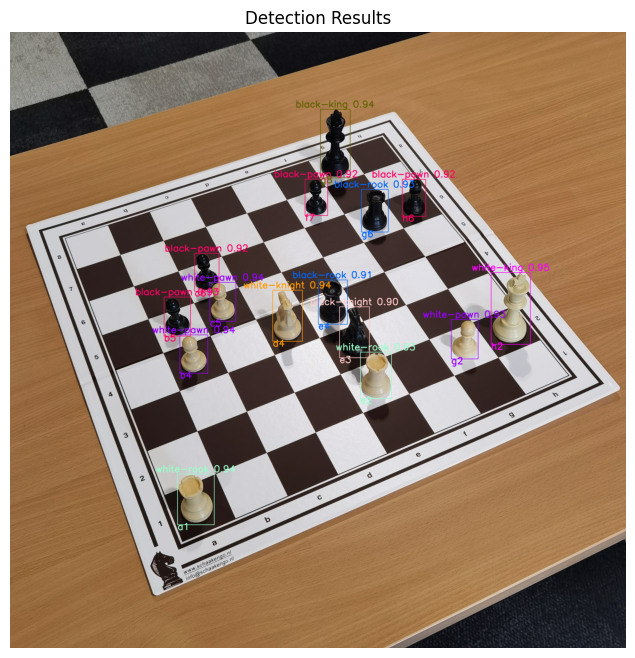

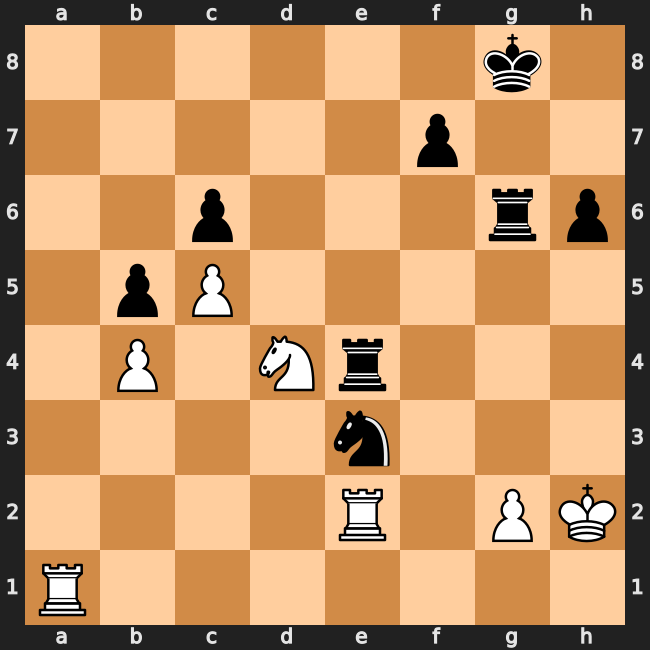

FEN: 6k1/5p2/2p3rp/1pP5/1P1Nr3/4n3/4R1PK/R7 w - - 0 1

🔎 Processing G000_IMG087.jpg

0: 640x640 1 white-pawn, 1 white-rook, 1 white-knight, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-knight, 1 black-king, 32.5ms
Speed: 3.1ms preprocess, 32.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


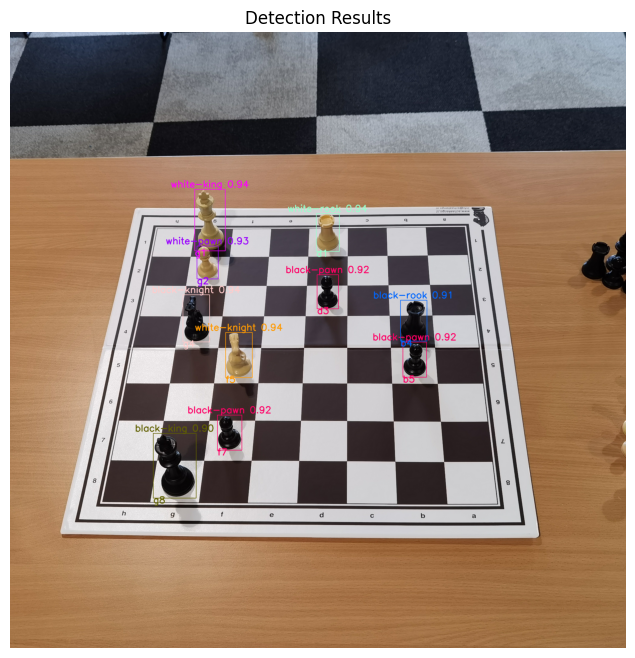

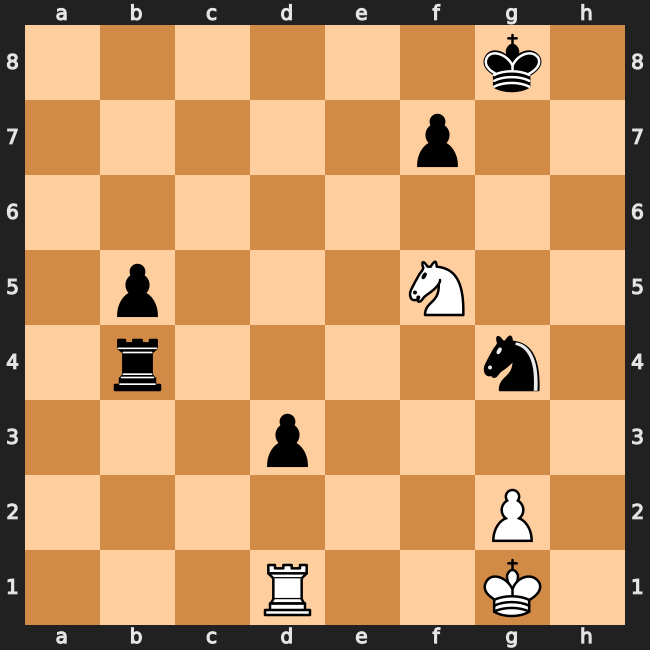

FEN: 6k1/5p2/8/1p3N2/1r4n1/3p4/6P1/3R2K1 w - - 0 1

🔎 Processing G000_IMG102.jpg

0: 640x640 1 white-pawn, 1 white-rook, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-king, 11.1ms
Speed: 3.0ms preprocess, 11.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


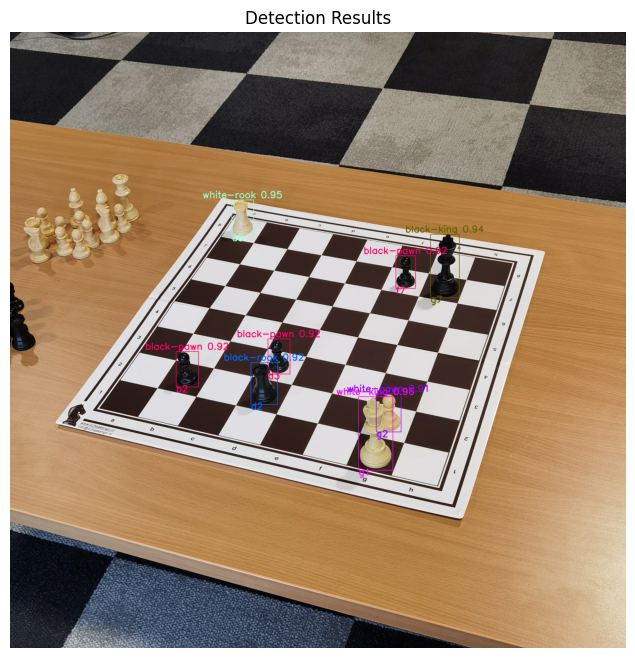

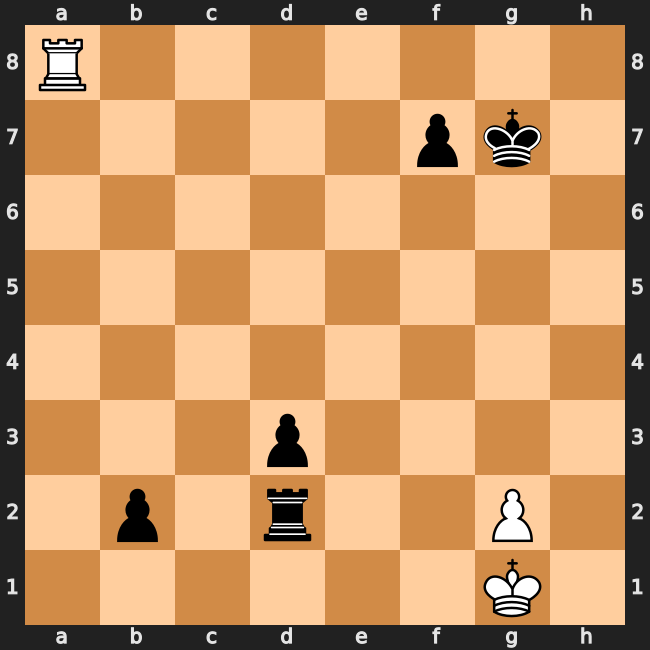

FEN: R7/5pk1/8/8/8/3p4/1p1r2P1/6K1 w - - 0 1

🔎 Processing G006_IMG048.jpg

0: 640x640 6 white-pawns, 2 white-rooks, 1 white-knight, 2 white-bishops, 1 white-queen, 1 white-king, 7 black-pawns, 3 black-rooks, 1 black-knight, 1 black-bishop, 1 black-queen, 2 black-kings, 17.6ms
Speed: 2.9ms preprocess, 17.6ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 98.4375%


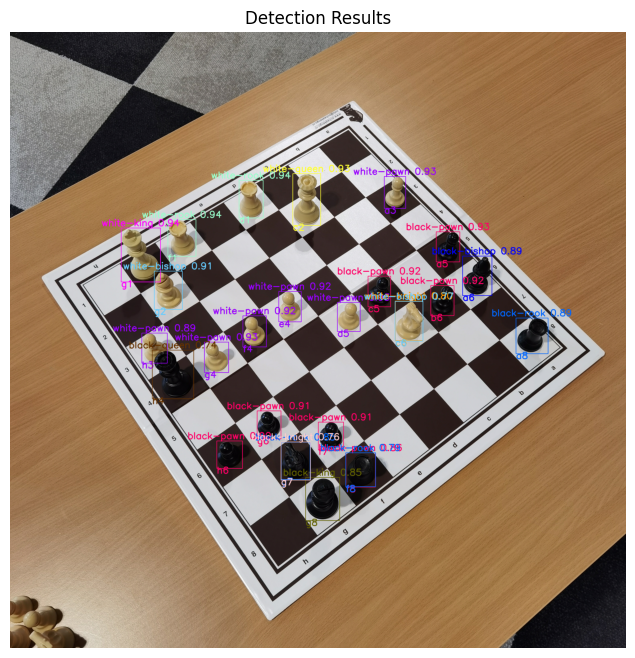

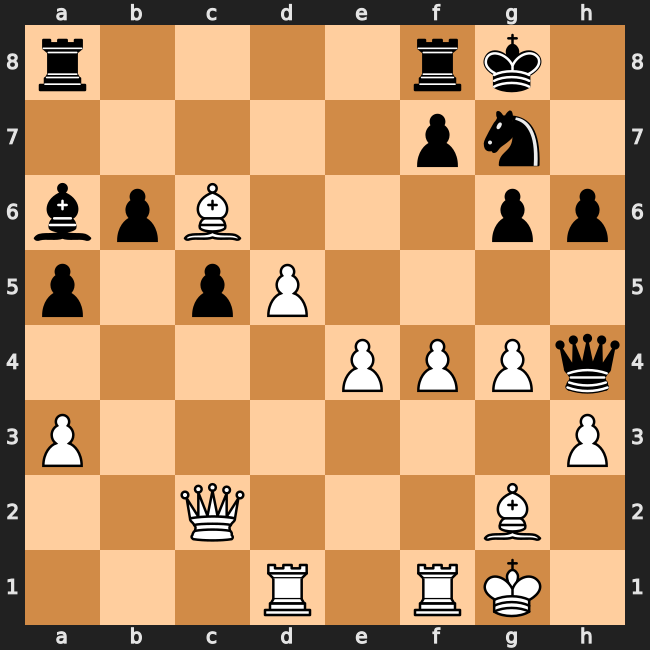

FEN: r4rk1/5pn1/bpB3pp/p1pP4/4PPPq/P6P/2Q3B1/3R1RK1 w - - 0 1

🔎 Processing G006_IMG086.jpg

0: 640x640 3 white-pawns, 1 white-rook, 1 white-knight, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-king, 11.7ms
Speed: 8.8ms preprocess, 11.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


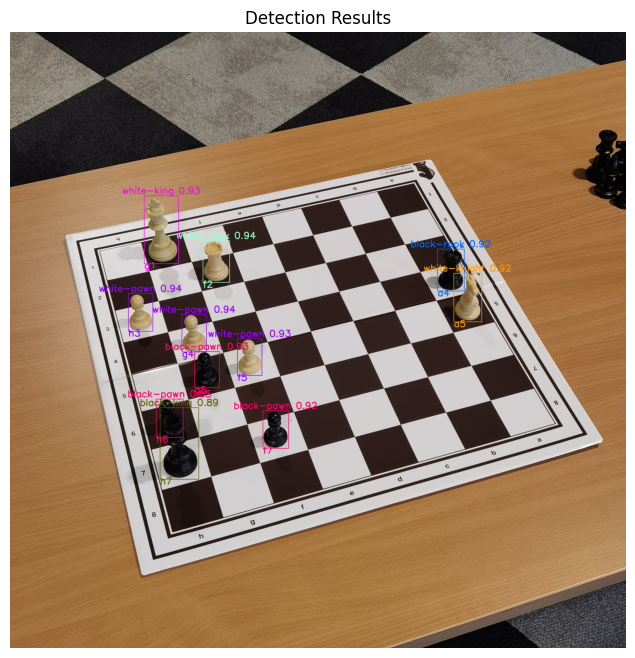

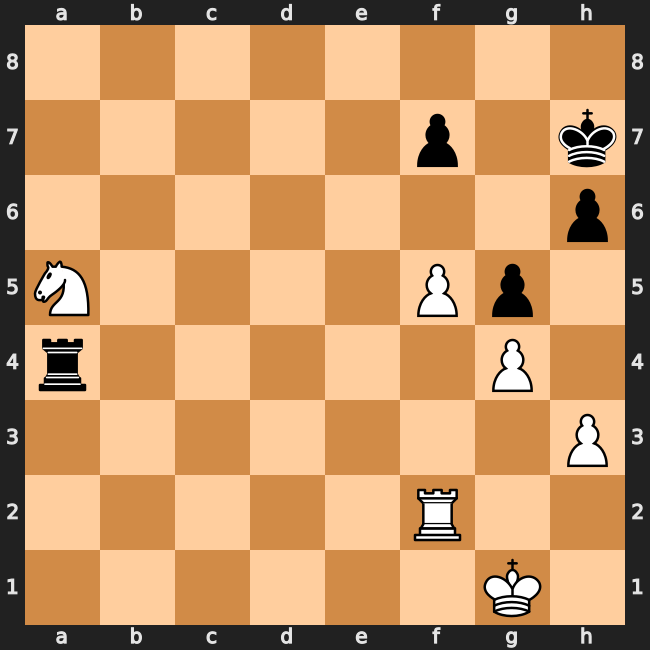

FEN: 8/5p1k/7p/N4Pp1/r5P1/7P/5R2/6K1 w - - 0 1

🔎 Processing G006_IMG119.jpg

0: 640x640 2 white-pawns, 1 white-rook, 1 white-knight, 1 white-king, 1 black-pawn, 1 black-rook, 1 black-king, 18.2ms
Speed: 3.4ms preprocess, 18.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


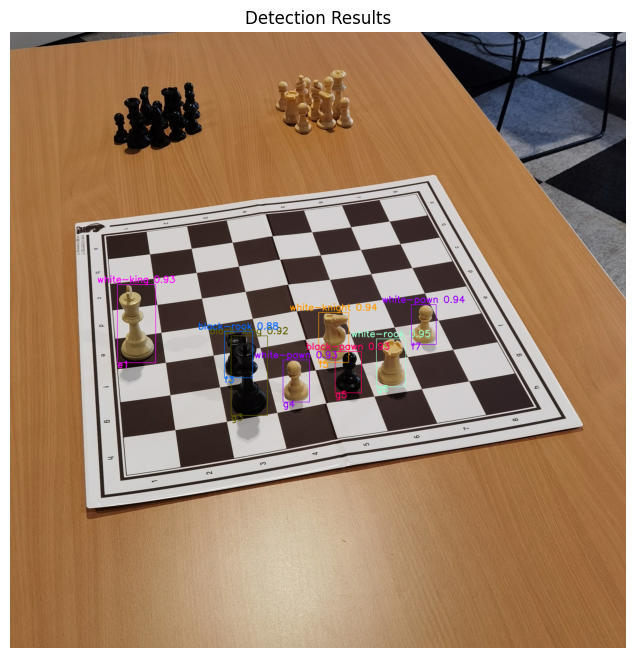

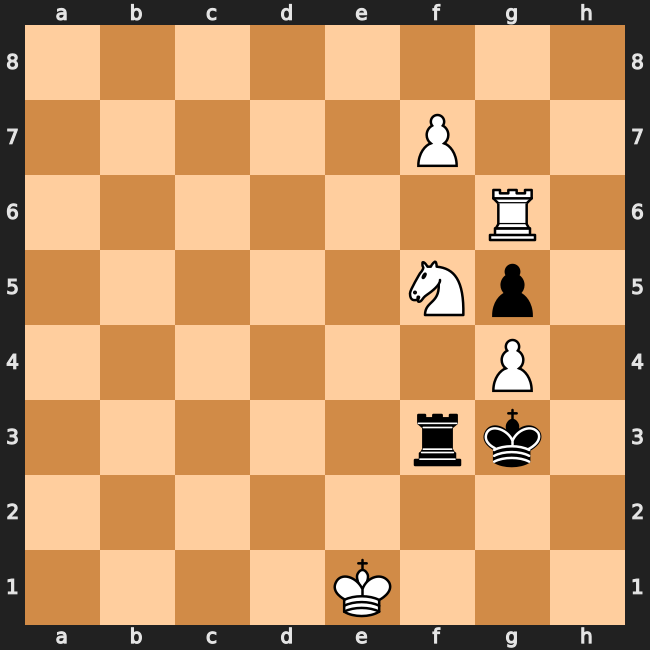

FEN: 8/5P2/6R1/5Np1/6P1/5rk1/8/4K3 w - - 0 1

🔎 Processing G019_IMG082.jpg

0: 640x640 4 white-pawns, 1 white-knight, 1 white-queen, 1 white-king, 4 black-pawns, 1 black-bishop, 1 black-queen, 1 black-king, 17.0ms
Speed: 3.1ms preprocess, 17.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


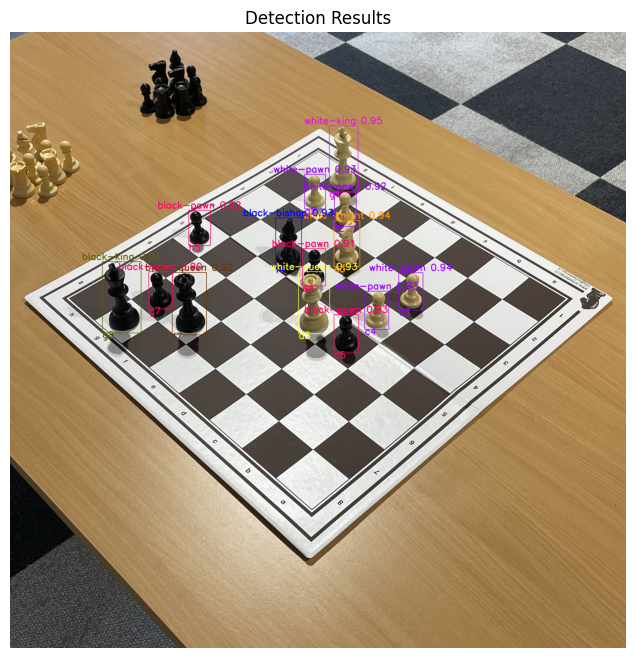

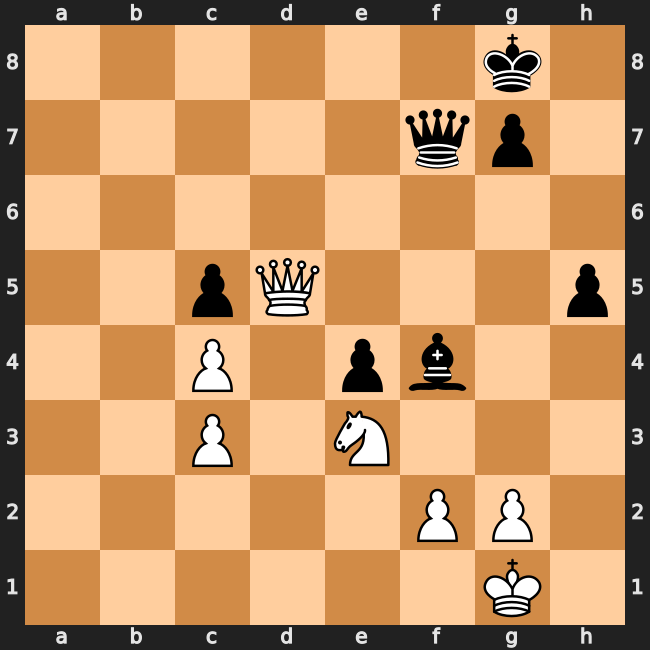

FEN: 6k1/5qp1/8/2pQ3p/2P1pb2/2P1N3/5PP1/6K1 w - - 0 1

🔎 Processing G028_IMG015.jpg

0: 640x640 7 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 7 black-pawns, 2 black-rooks, 2 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 16.8ms
Speed: 3.1ms preprocess, 16.8ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


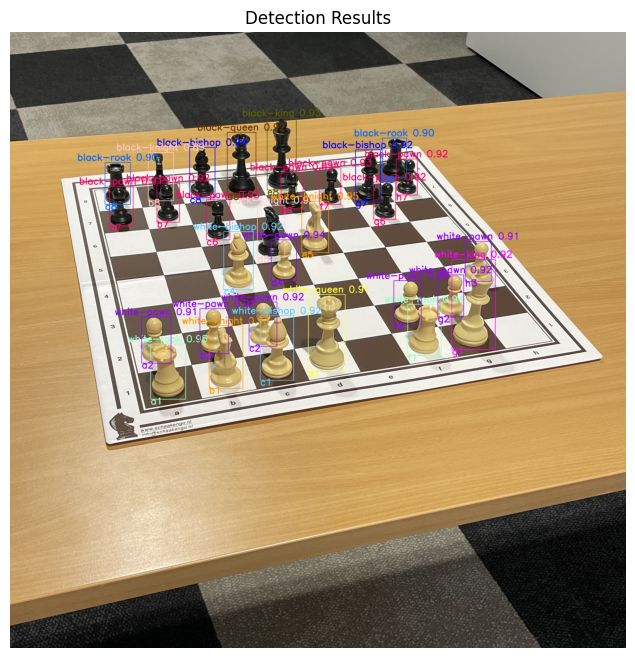

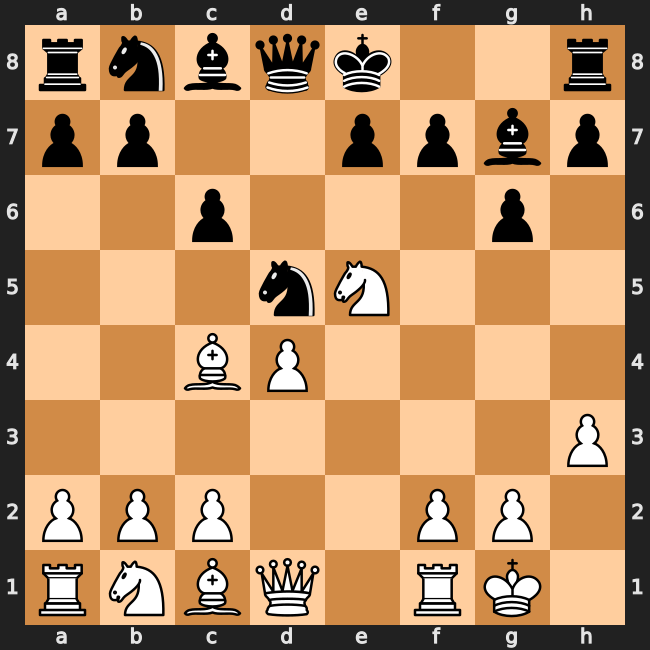

FEN: rnbqk2r/pp2ppbp/2p3p1/3nN3/2BP4/7P/PPP2PP1/RNBQ1RK1 w - - 0 1

🔎 Processing G028_IMG062.jpg

0: 640x640 5 white-pawns, 2 white-rooks, 1 white-bishop, 1 white-queen, 1 white-king, 7 black-pawns, 1 black-rook, 1 black-knight, 1 black-bishop, 1 black-queen, 1 black-king, 12.9ms
Speed: 3.0ms preprocess, 12.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


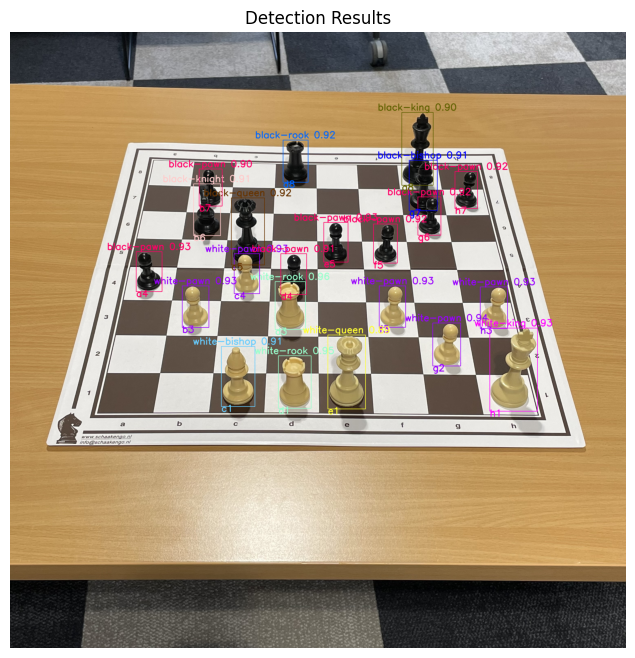

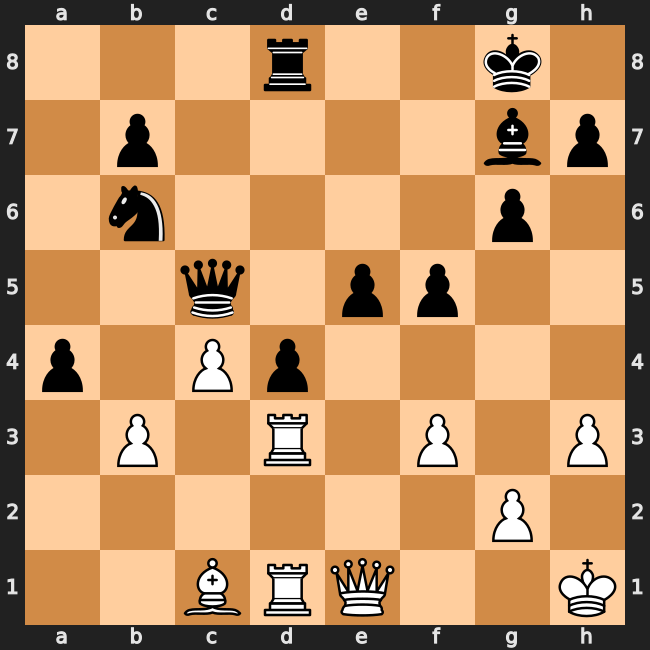

FEN: 3r2k1/1p4bp/1n4p1/2q1pp2/p1Pp4/1P1R1P1P/6P1/2BRQ2K w - - 0 1

🔎 Processing G028_IMG098.jpg

0: 640x640 4 white-pawns, 1 white-rook, 1 white-queen, 1 white-king, 4 black-pawns, 1 black-rook, 1 black-queen, 1 black-king, 15.0ms
Speed: 2.9ms preprocess, 15.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


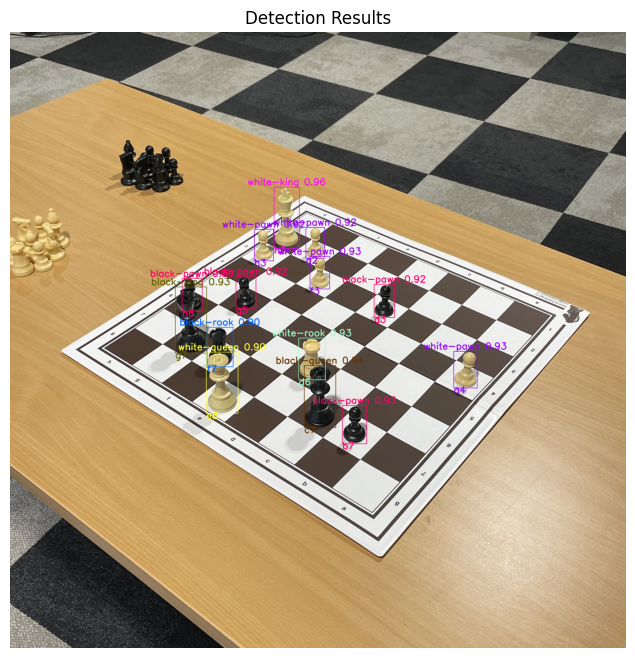

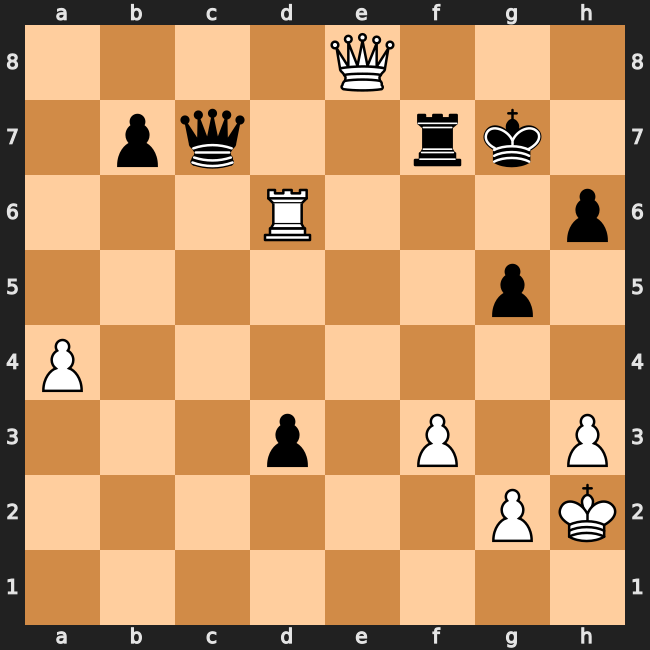

FEN: 4Q3/1pq2rk1/3R3p/6p1/P7/3p1P1P/6PK/8 w - - 0 1

🔎 Processing G028_IMG101.jpg

0: 640x640 4 white-pawns, 1 white-rook, 1 white-queen, 1 white-king, 4 black-pawns, 1 black-rook, 1 black-queen, 1 black-king, 10.5ms
Speed: 2.8ms preprocess, 10.5ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


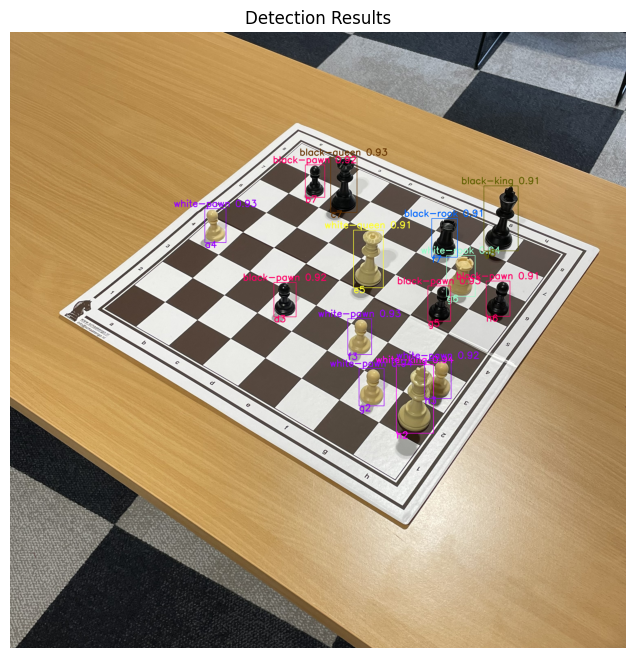

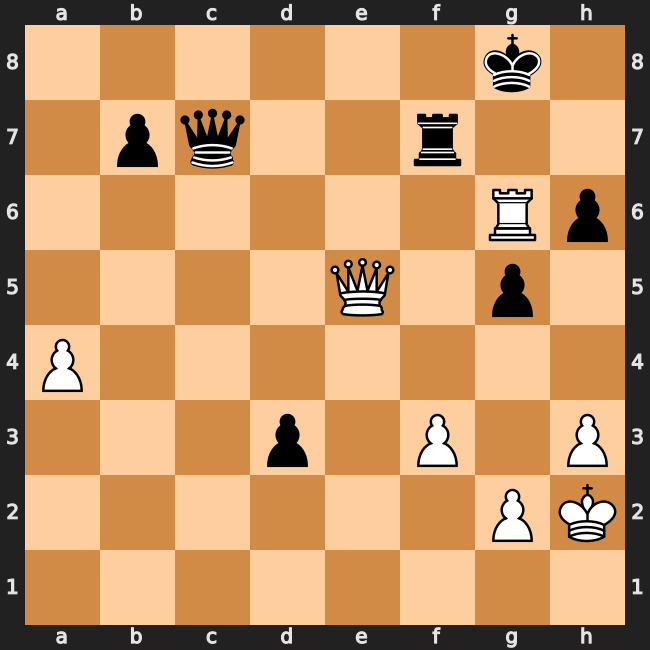

FEN: 6k1/1pq2r2/6Rp/4Q1p1/P7/3p1P1P/6PK/8 w - - 0 1

🔎 Processing G033_IMG043.jpg

0: 640x640 5 white-pawns, 3 white-rooks, 1 white-knight, 2 white-bishops, 1 white-queen, 1 white-king, 5 black-pawns, 2 black-rooks, 2 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 11.3ms
Speed: 7.7ms preprocess, 11.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


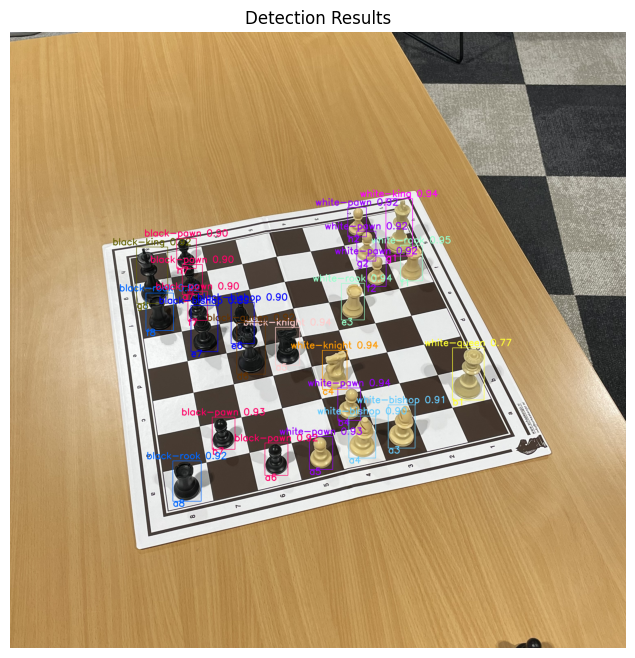

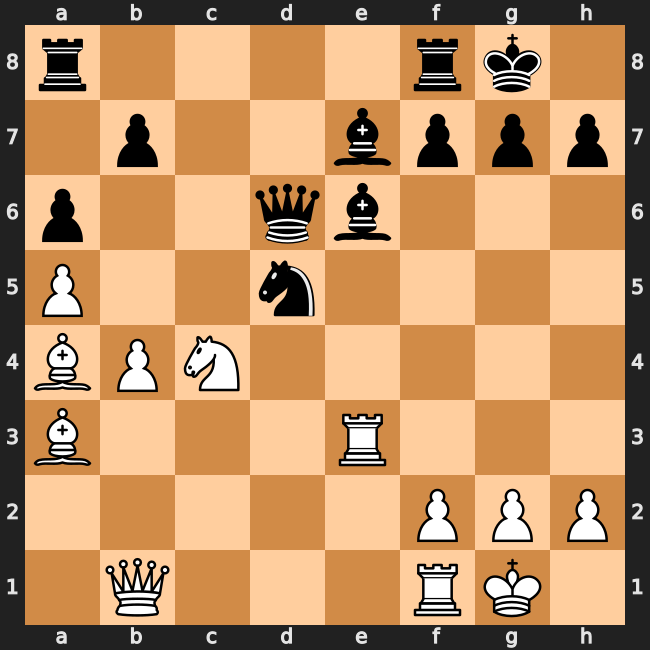

FEN: r4rk1/1p2bppp/p2qb3/P2n4/BPN5/B3R3/5PPP/1Q3RK1 w - - 0 1

🔎 Processing G033_IMG075.jpg

0: 640x640 4 white-pawns, 1 white-king, 4 black-pawns, 1 black-king, 14.3ms
Speed: 2.8ms preprocess, 14.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


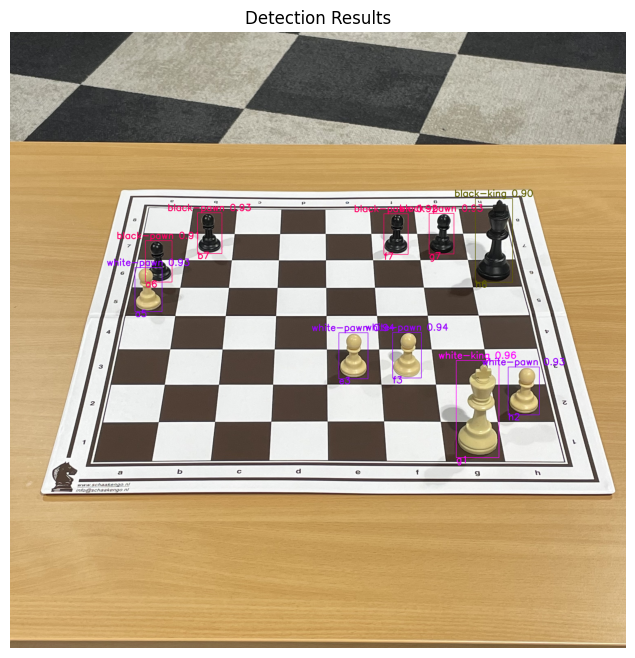

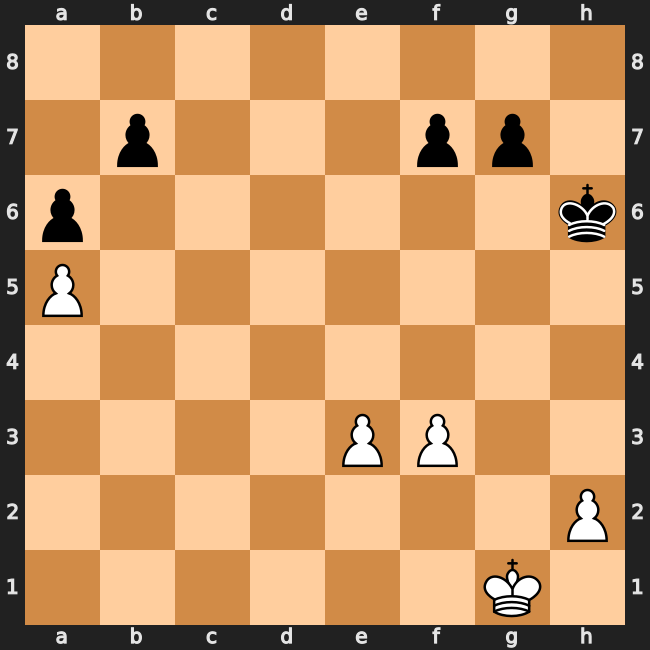

FEN: 8/1p3pp1/p6k/P7/8/4PP2/7P/6K1 w - - 0 1

🔎 Processing G033_IMG088.jpg

0: 640x640 4 white-pawns, 1 white-king, 4 black-pawns, 1 black-king, 9.8ms
Speed: 2.7ms preprocess, 9.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


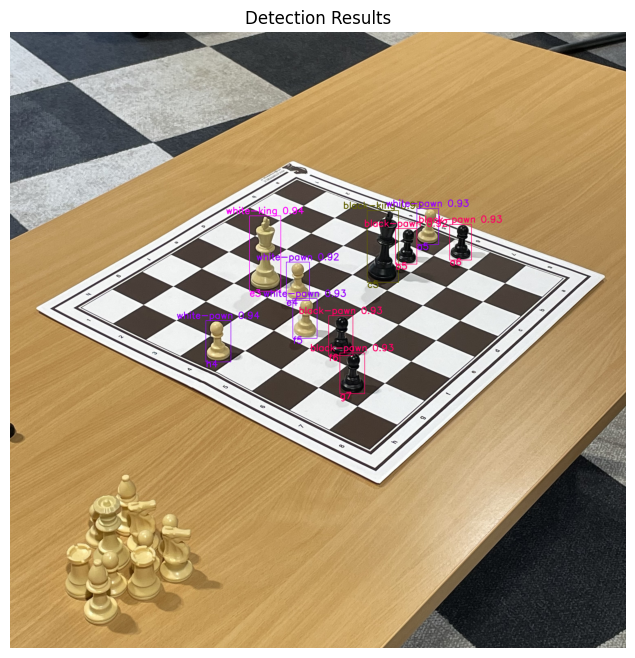

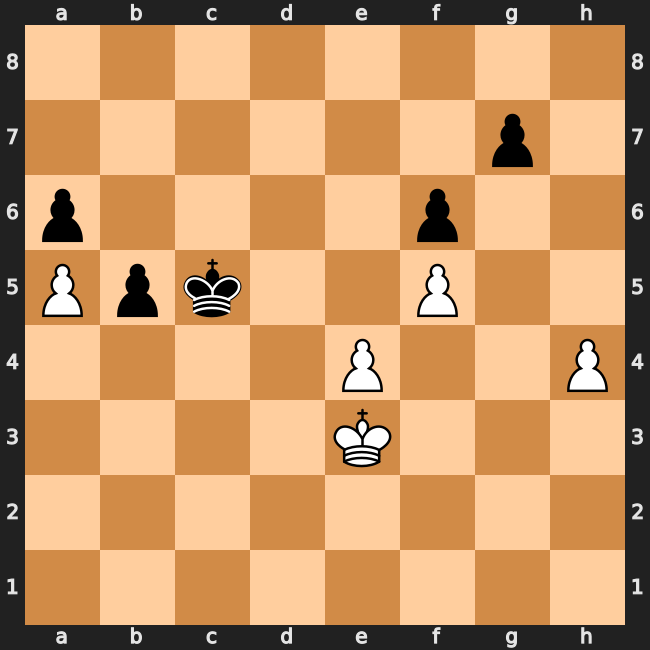

FEN: 8/6p1/p4p2/Ppk2P2/4P2P/4K3/8/8 w - - 0 1

🔎 Processing G033_IMG101.jpg

0: 640x640 1 white-queen, 1 white-king, 3 black-pawns, 1 black-king, 13.8ms
Speed: 2.9ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


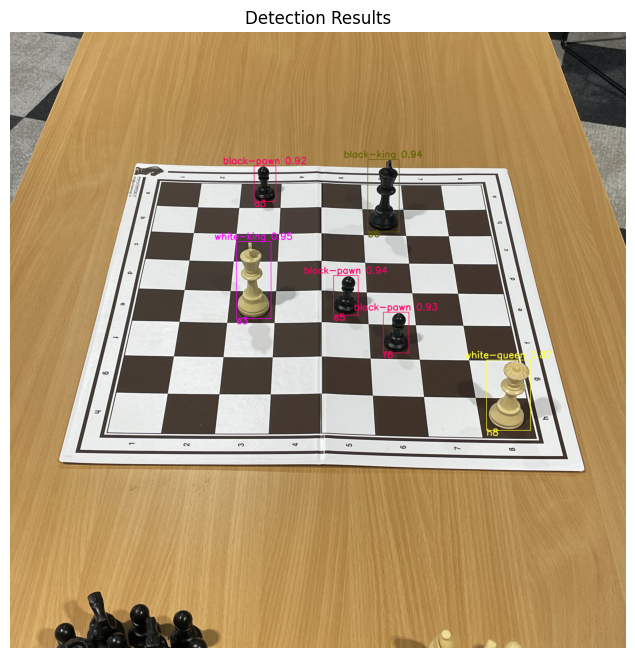

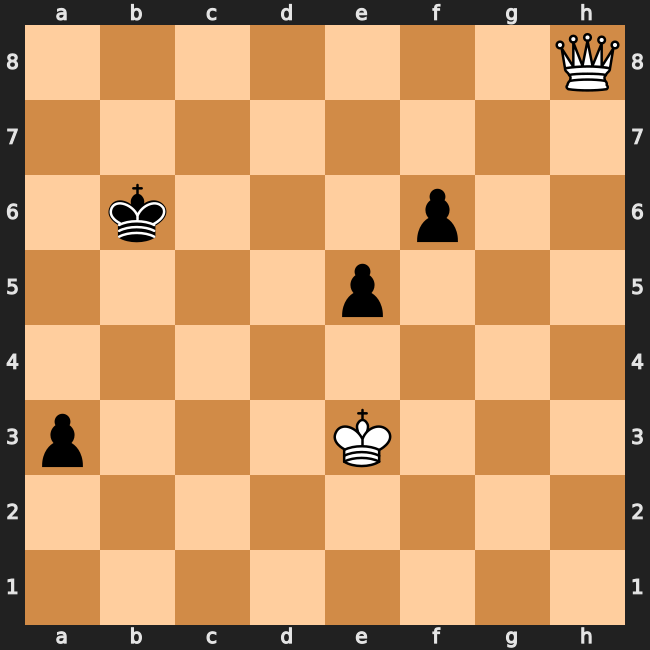

FEN: 7Q/8/1k3p2/4p3/8/p3K3/8/8 w - - 0 1

🔎 Processing G038_IMG074.jpg

0: 640x640 4 white-pawns, 2 white-rooks, 1 white-bishop, 1 white-king, 2 black-pawns, 2 black-rooks, 1 black-knight, 1 black-king, 9.8ms
Speed: 7.7ms preprocess, 9.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


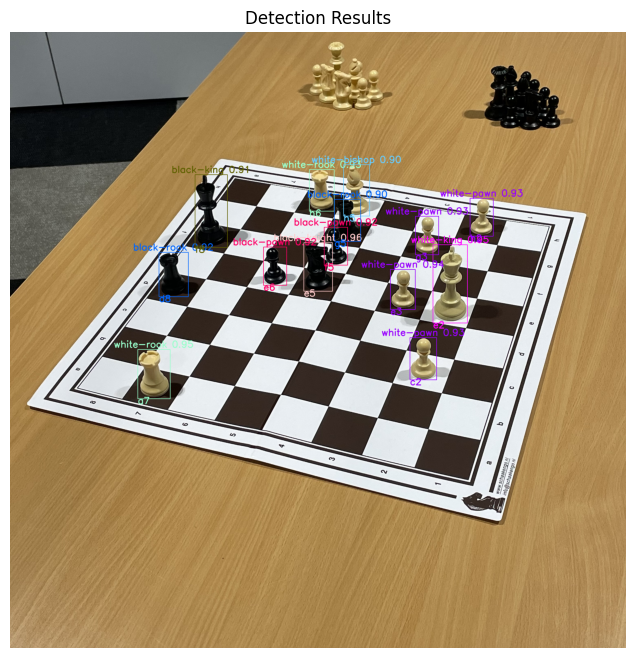

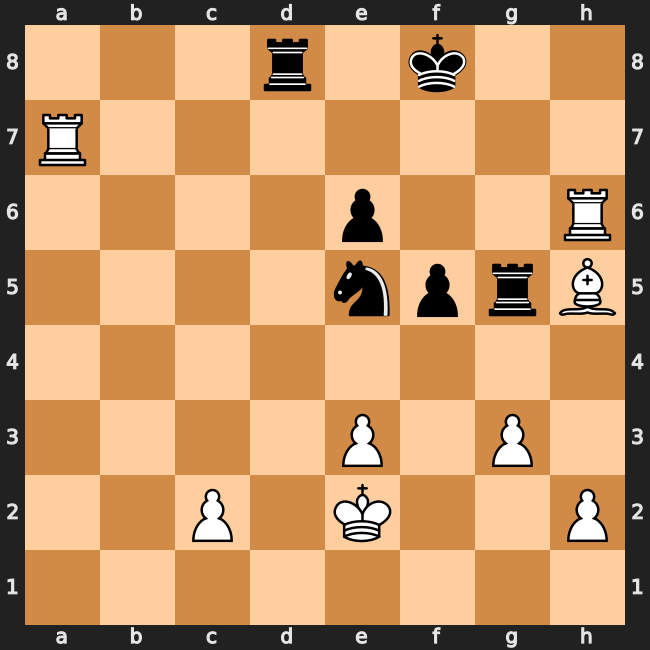

FEN: 3r1k2/R7/4p2R/4nprB/8/4P1P1/2P1K2P/8 w - - 0 1

🔎 Processing G038_IMG088.jpg

0: 640x640 4 white-pawns, 2 white-rooks, 1 white-king, 2 black-pawns, 2 black-rooks, 1 black-king, 24.4ms
Speed: 2.9ms preprocess, 24.4ms inference, 7.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


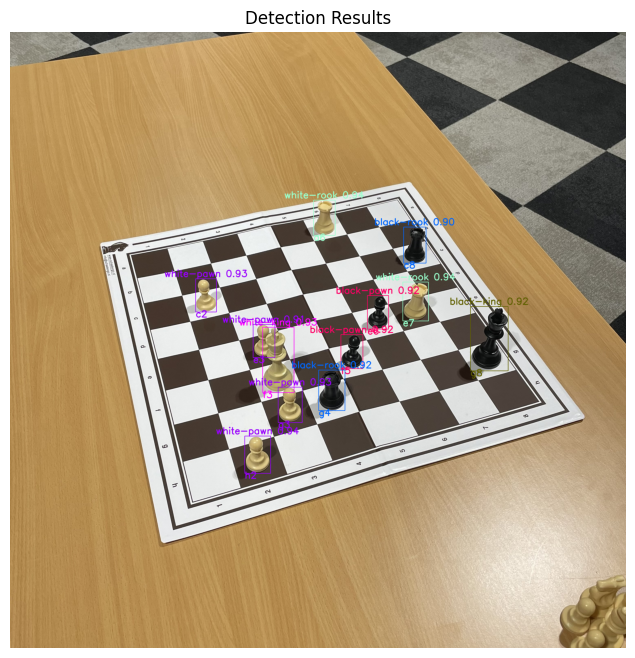

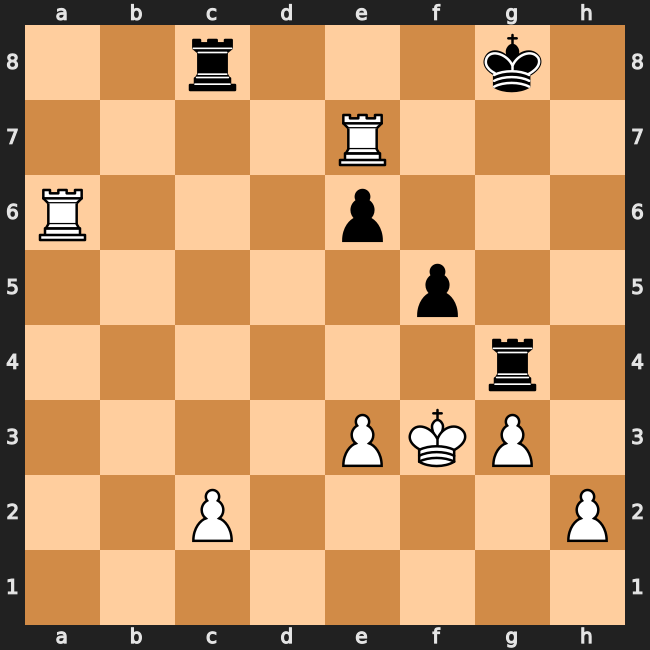

FEN: 2r3k1/4R3/R3p3/5p2/6r1/4PKP1/2P4P/8 w - - 0 1

🔎 Processing G038_IMG103.jpg

0: 640x640 3 white-pawns, 2 white-rooks, 1 white-king, 1 black-pawn, 2 black-rooks, 1 black-king, 12.3ms
Speed: 6.6ms preprocess, 12.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


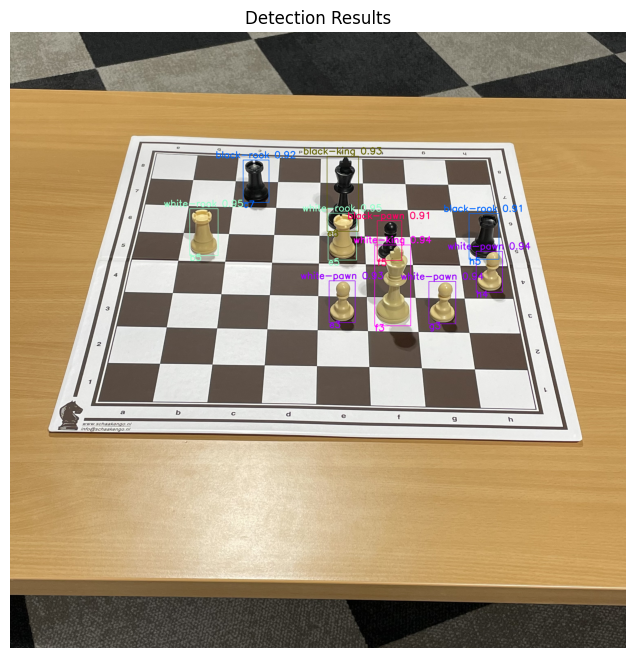

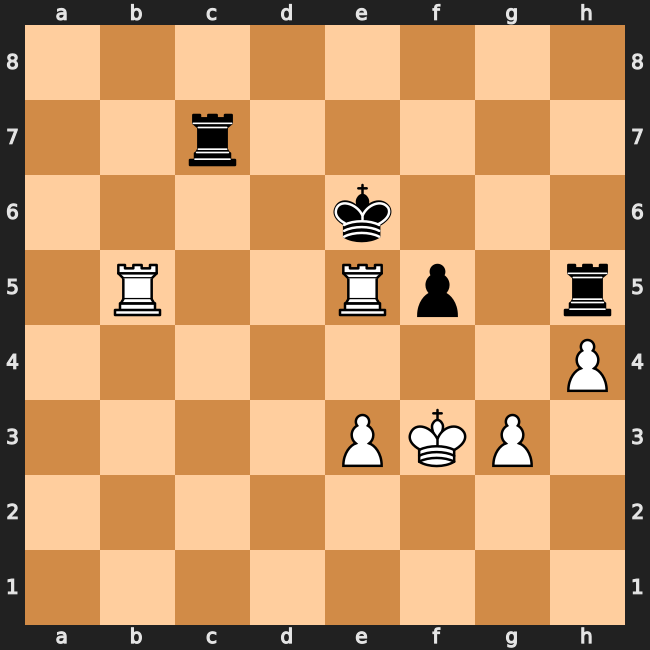

FEN: 8/2r5/4k3/1R2Rp1r/7P/4PKP1/8/8 w - - 0 1

🔎 Processing G038_IMG105.jpg

0: 640x640 3 white-pawns, 2 white-rooks, 1 white-king, 1 black-pawn, 2 black-rooks, 1 black-king, 15.5ms
Speed: 2.8ms preprocess, 15.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


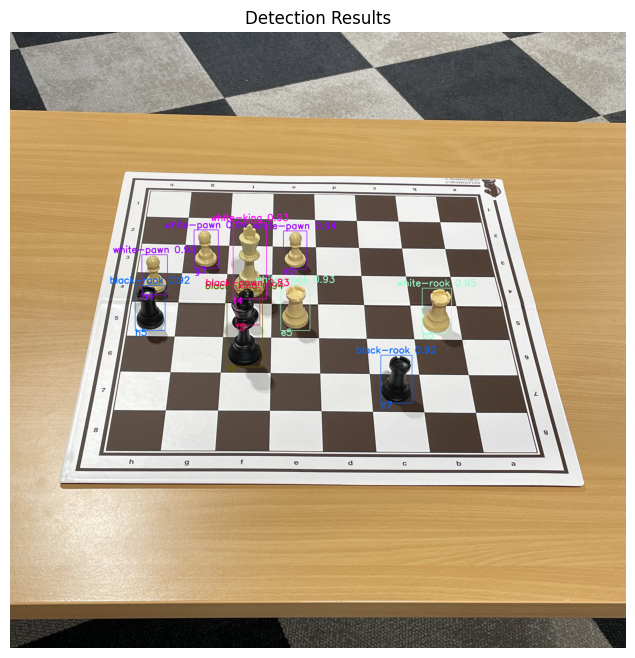

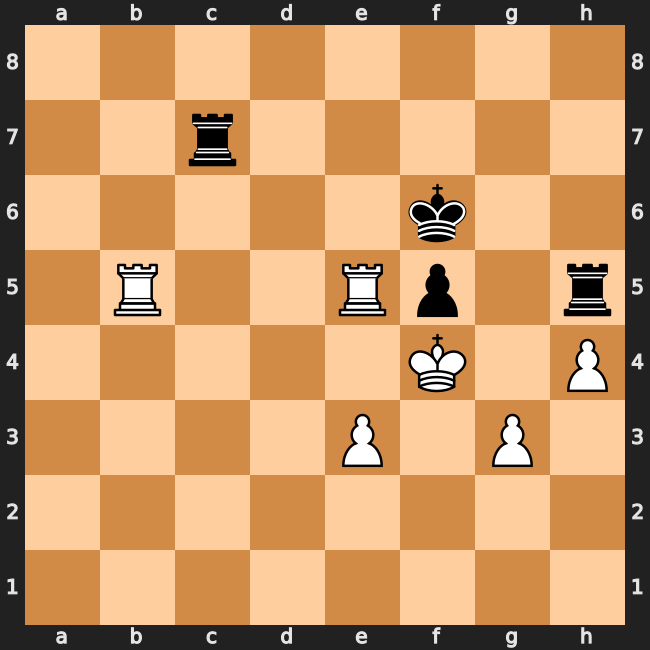

FEN: 8/2r5/5k2/1R2Rp1r/5K1P/4P1P1/8/8 w - - 0 1

🔎 Processing G041_IMG042.jpg

0: 640x640 6 white-pawns, 2 white-rooks, 2 white-bishops, 1 white-king, 5 black-pawns, 2 black-rooks, 2 black-knights, 1 black-king, 20.7ms
Speed: 3.3ms preprocess, 20.7ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


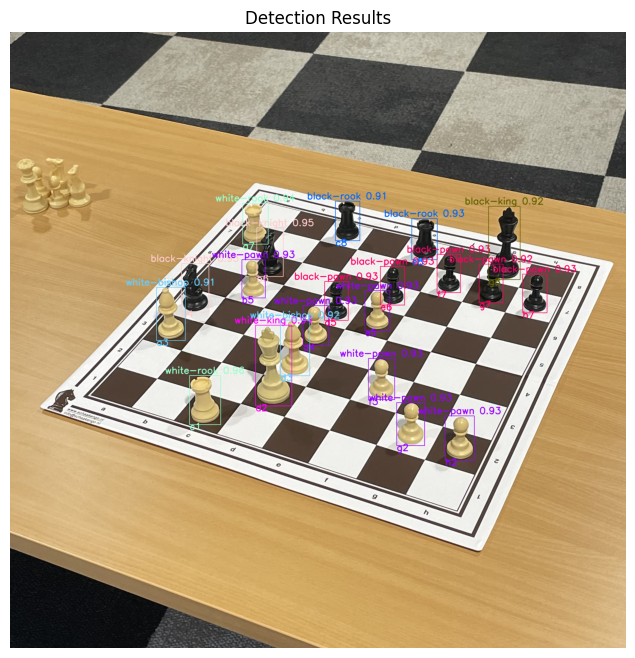

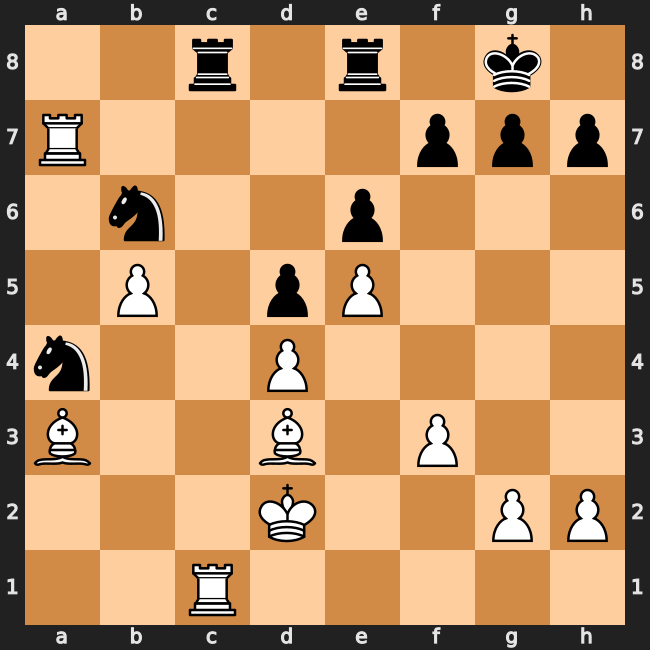

FEN: 2r1r1k1/R4ppp/1n2p3/1P1pP3/n2P4/B2B1P2/3K2PP/2R5 w - - 0 1

🔎 Processing G041_IMG048.jpg

0: 640x640 6 white-pawns, 1 white-rook, 2 white-bishops, 1 white-king, 5 black-pawns, 1 black-rook, 2 black-knights, 1 black-king, 28.2ms
Speed: 2.9ms preprocess, 28.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


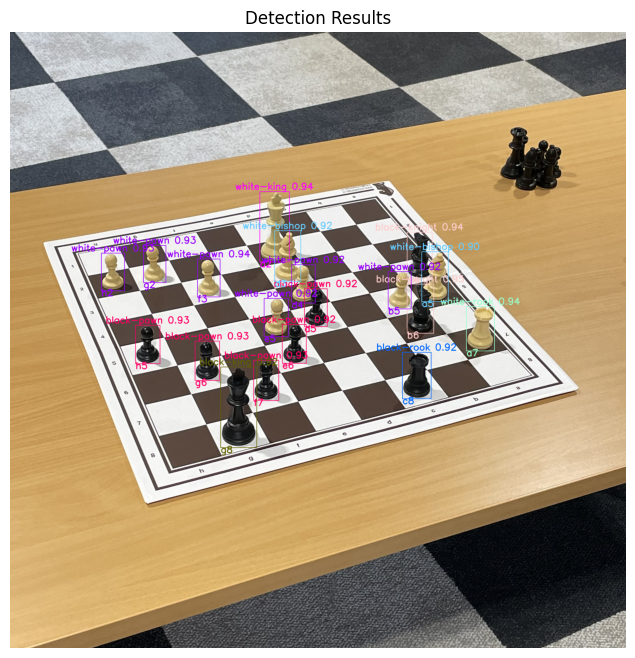

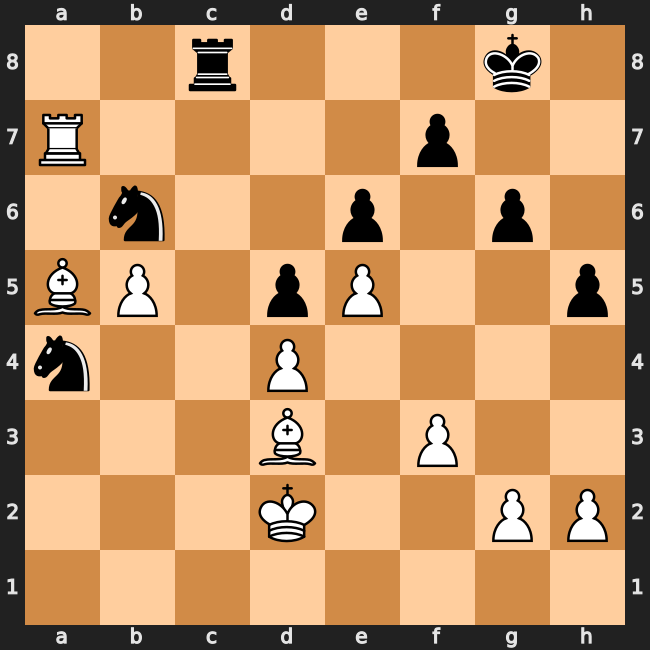

FEN: 2r3k1/R4p2/1n2p1p1/BP1pP2p/n2P4/3B1P2/3K2PP/8 w - - 0 1

🔎 Processing G041_IMG088.jpg

0: 640x640 2 white-pawns, 1 white-rook, 1 white-queen, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-king, 12.3ms
Speed: 3.0ms preprocess, 12.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


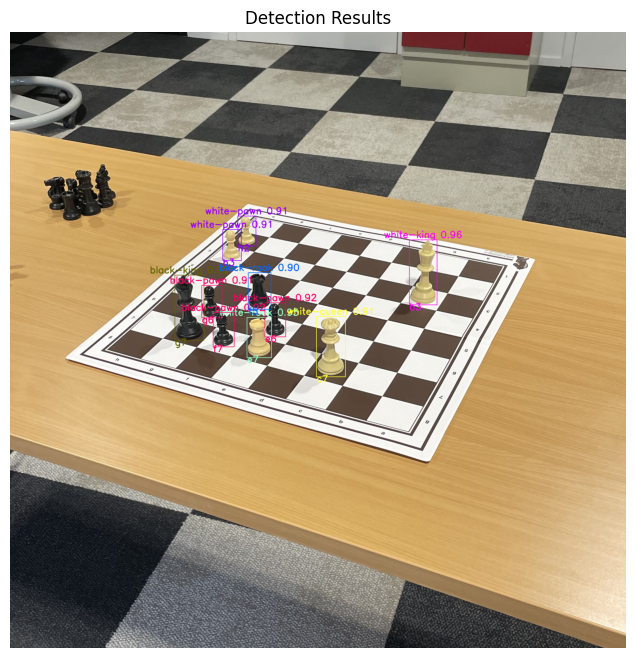

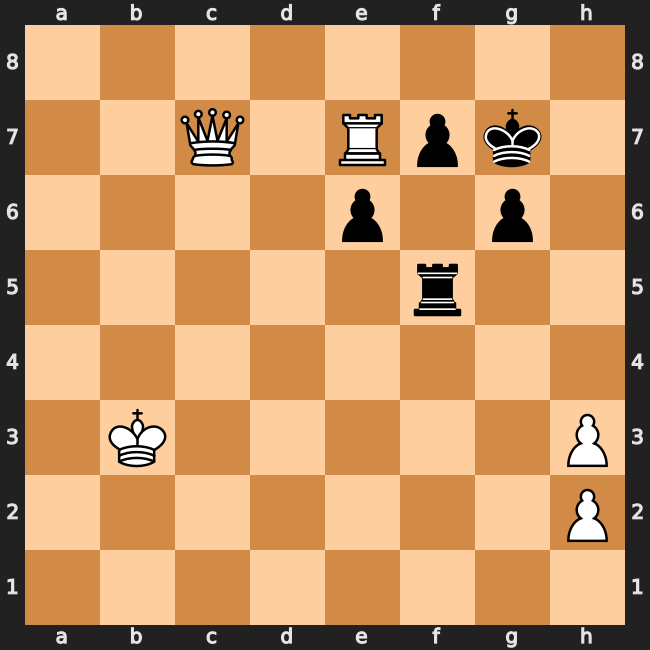

FEN: 8/2Q1Rpk1/4p1p1/5r2/8/1K5P/7P/8 w - - 0 1

🔎 Processing G041_IMG098.jpg

0: 640x640 2 white-pawns, 1 white-rook, 1 white-queen, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-king, 28.3ms
Speed: 3.4ms preprocess, 28.3ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


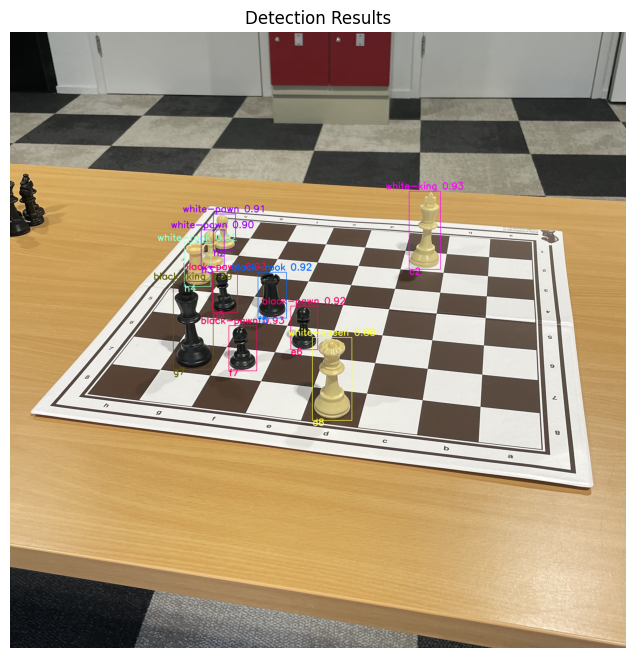

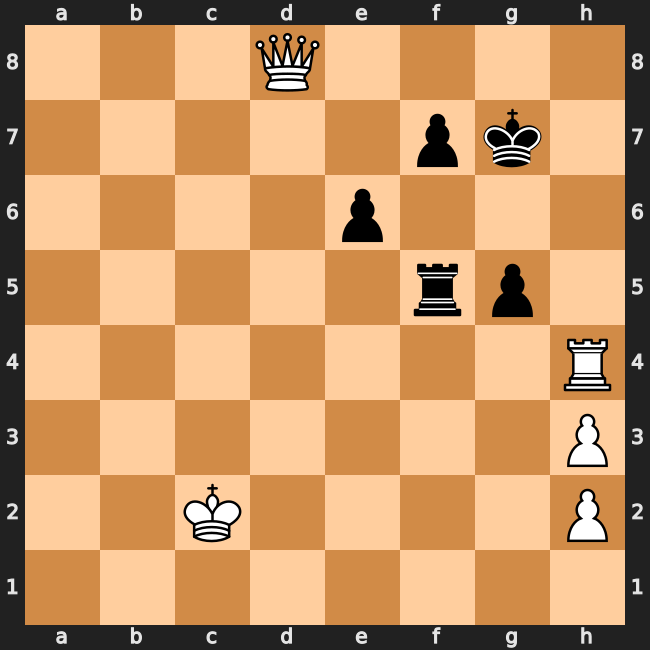

FEN: 3Q4/5pk1/4p3/5rp1/7R/7P/2K4P/8 w - - 0 1

🔎 Processing G047_IMG053.jpg

0: 640x640 6 white-pawns, 1 white-rook, 1 white-bishop, 1 white-king, 5 black-pawns, 2 black-rooks, 1 black-king, 9.1ms
Speed: 2.7ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


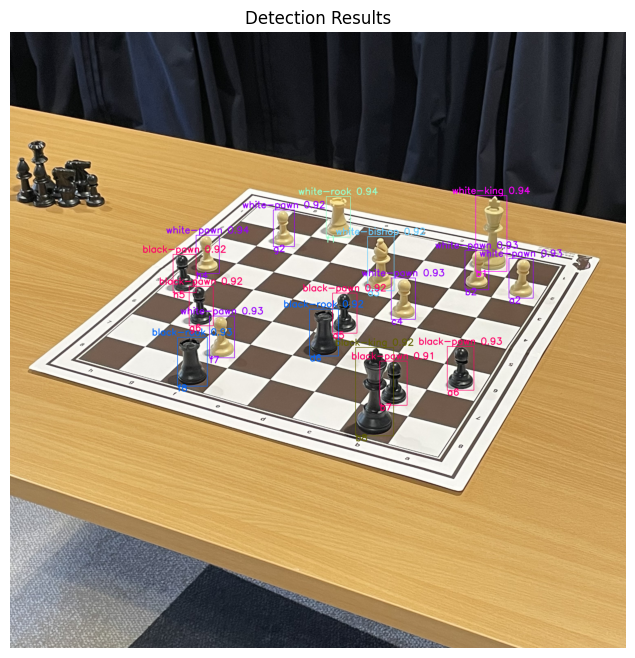

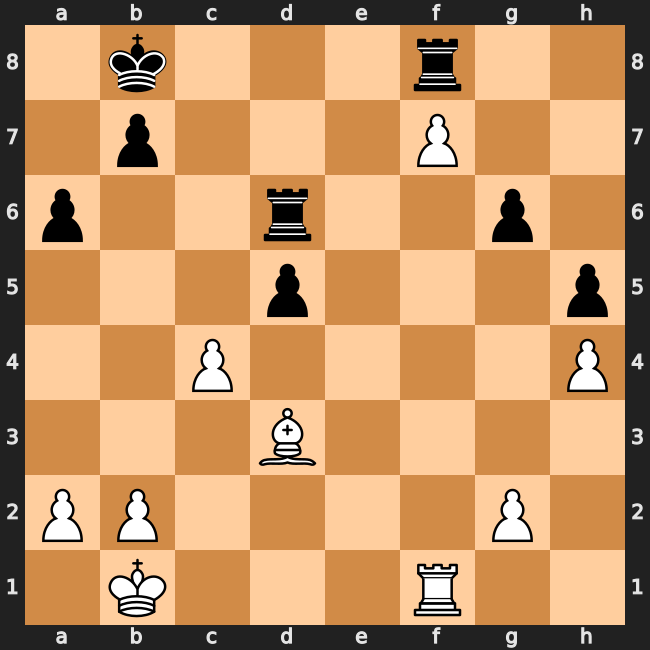

FEN: 1k3r2/1p3P2/p2r2p1/3p3p/2P4P/3B4/PP4P1/1K3R2 w - - 0 1

🔎 Processing G047_IMG068.jpg

0: 640x640 4 white-pawns, 1 white-rook, 1 white-king, 4 black-pawns, 1 black-rook, 1 black-king, 31.4ms
Speed: 4.9ms preprocess, 31.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


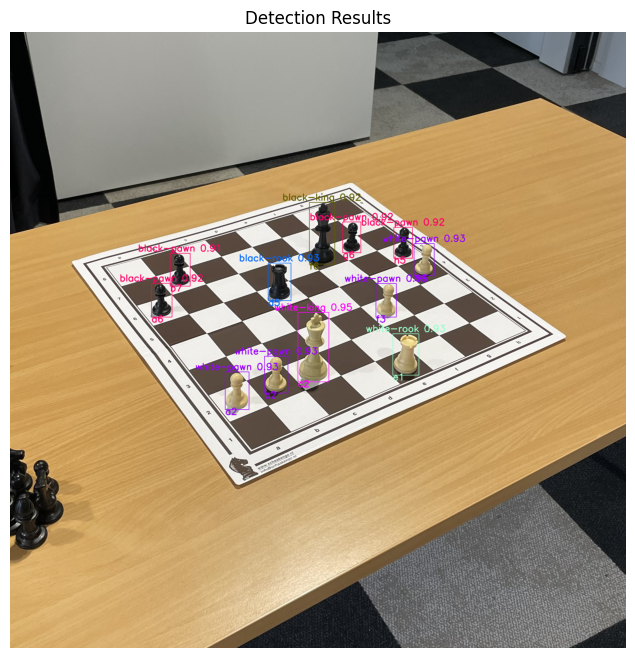

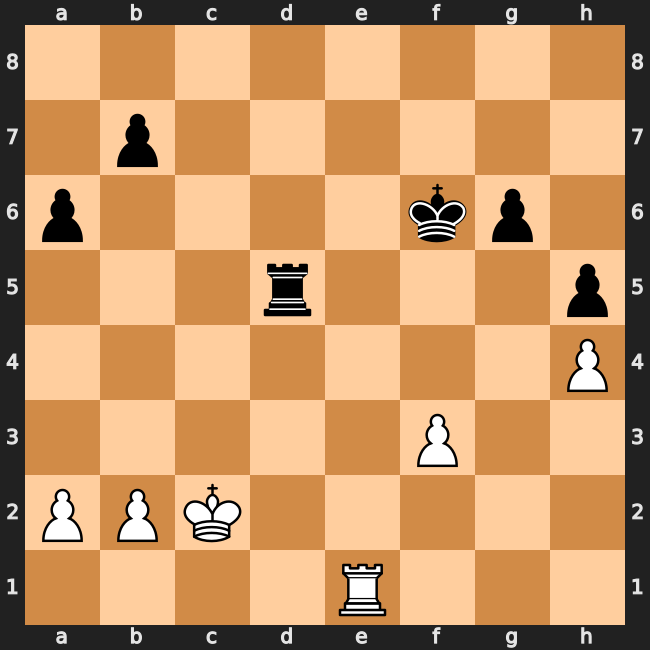

FEN: 8/1p6/p4kp1/3r3p/7P/5P2/PPK5/4R3 w - - 0 1

🔎 Processing G047_IMG102.jpg

0: 640x640 1 white-pawn, 1 white-rook, 1 white-king, 1 black-pawn, 1 black-rook, 1 black-king, 9.3ms
Speed: 2.8ms preprocess, 9.3ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


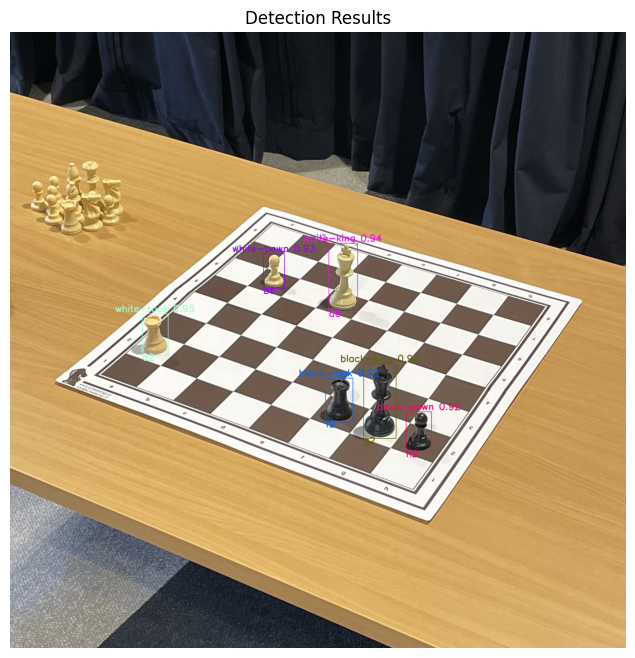

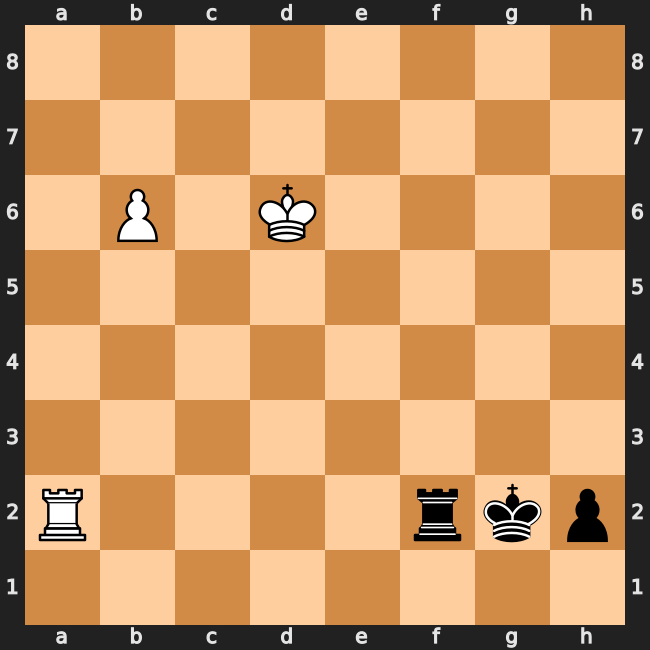

FEN: 8/8/1P1K4/8/8/8/R4rkp/8 w - - 0 1

🔎 Processing G047_IMG107.jpg

0: 640x640 1 white-pawn, 1 white-rook, 1 white-king, 1 black-pawn, 1 black-rook, 1 black-king, 5.9ms
Speed: 2.4ms preprocess, 5.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


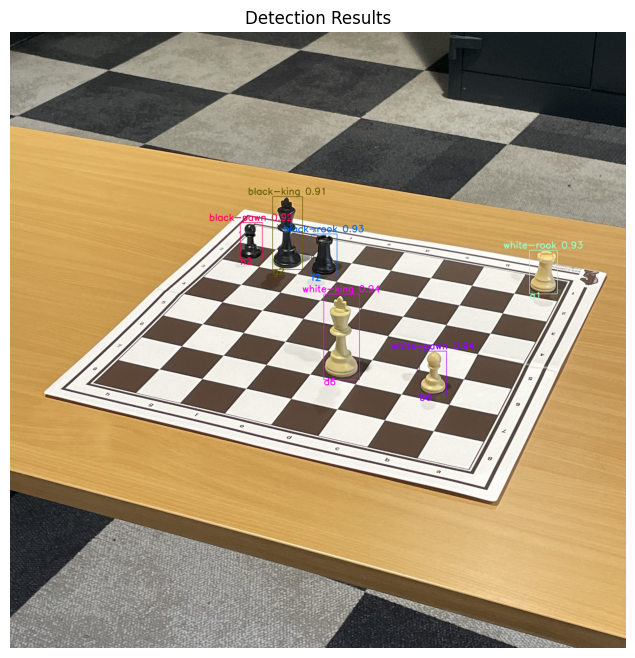

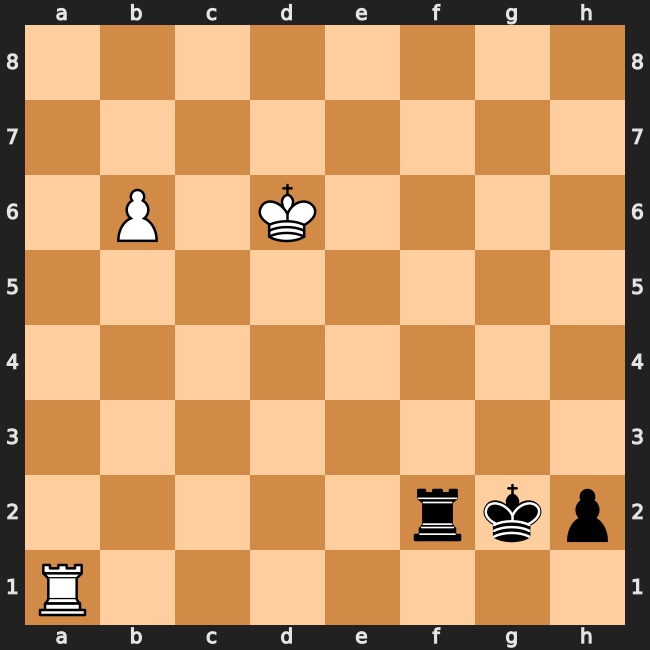

FEN: 8/8/1P1K4/8/8/8/5rkp/R7 w - - 0 1

🔎 Processing G056_IMG017.jpg

0: 640x640 7 white-pawns, 2 white-rooks, 2 white-knights, 1 white-bishop, 1 white-queen, 1 white-king, 7 black-pawns, 2 black-rooks, 1 black-knight, 2 black-bishops, 1 black-queen, 1 black-king, 5.9ms
Speed: 2.5ms preprocess, 5.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


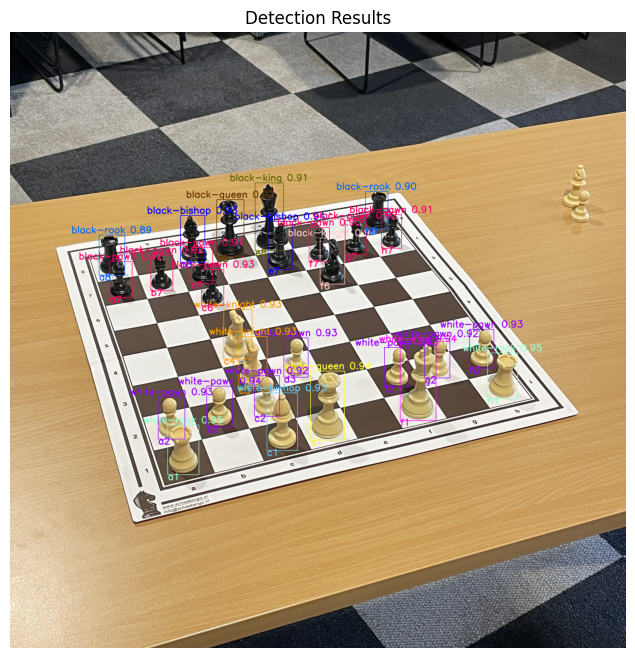

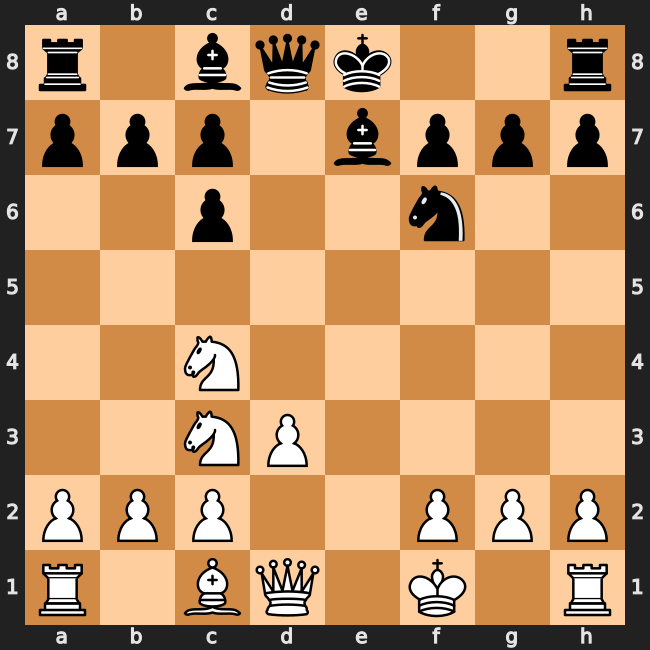

FEN: r1bqk2r/ppp1bppp/2p2n2/8/2N5/2NP4/PPP2PPP/R1BQ1K1R w - - 0 1

🔎 Processing G056_IMG077.jpg

0: 640x640 5 white-pawns, 1 white-bishop, 1 white-queen, 1 white-king, 6 black-pawns, 1 black-bishop, 1 black-queen, 1 black-king, 6.0ms
Speed: 2.5ms preprocess, 6.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


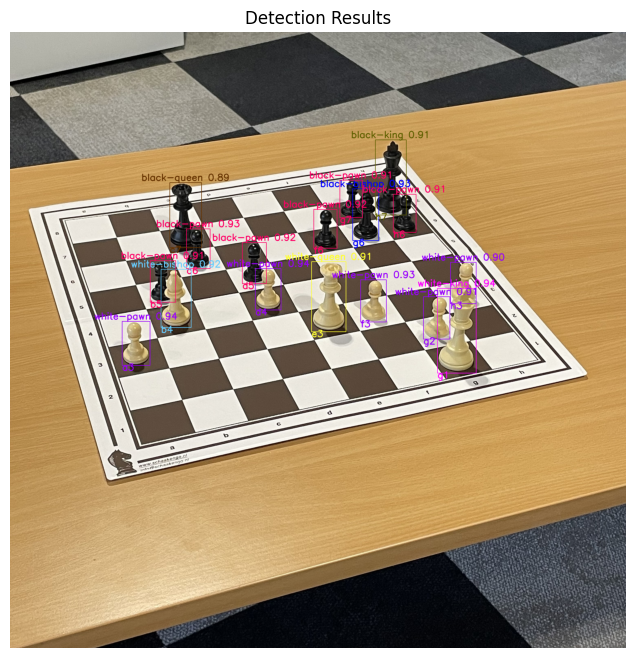

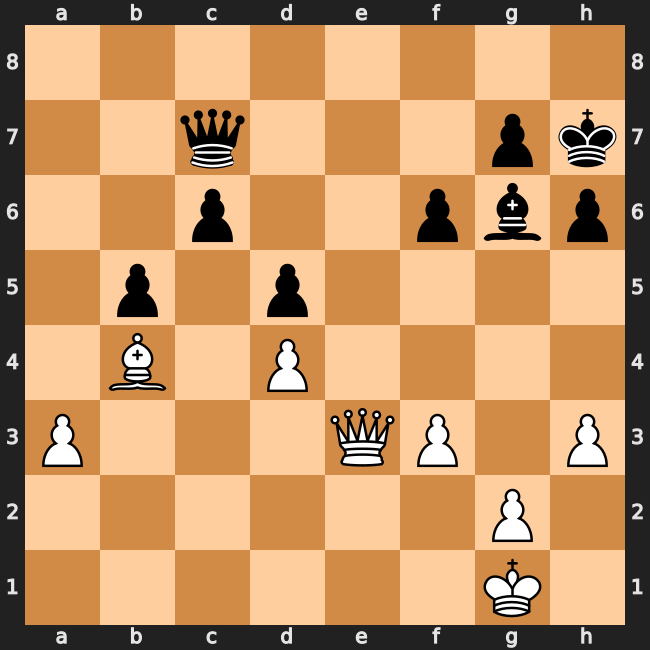

FEN: 8/2q3pk/2p2pbp/1p1p4/1B1P4/P3QP1P/6P1/6K1 w - - 0 1

🔎 Processing G056_IMG097.jpg

0: 640x640 5 white-pawns, 1 white-bishop, 1 white-queen, 1 white-king, 6 black-pawns, 1 black-bishop, 1 black-queen, 1 black-king, 6.1ms
Speed: 2.5ms preprocess, 6.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


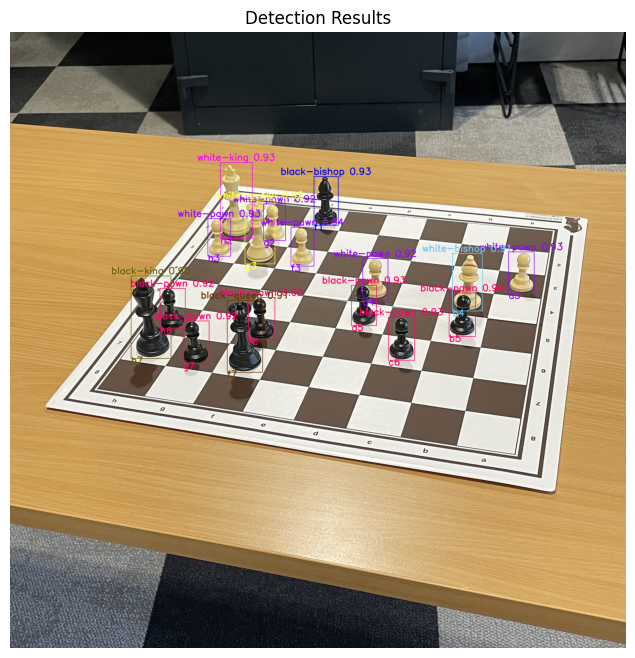

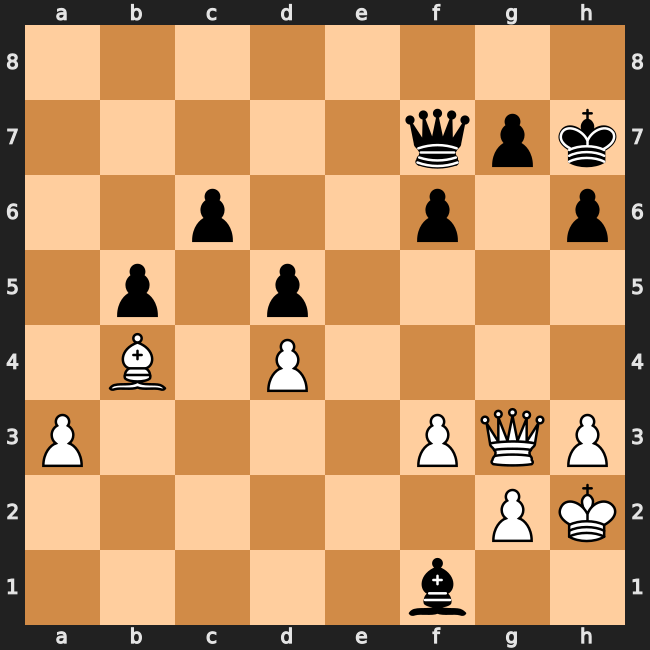

FEN: 8/5qpk/2p2p1p/1p1p4/1B1P4/P4PQP/6PK/5b2 w - - 0 1

🔎 Processing G058_IMG044.jpg

0: 640x640 5 white-pawns, 1 white-rook, 1 white-knight, 1 white-bishop, 1 white-king, 4 black-pawns, 1 black-rook, 2 black-bishops, 1 black-king, 5.5ms
Speed: 2.7ms preprocess, 5.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


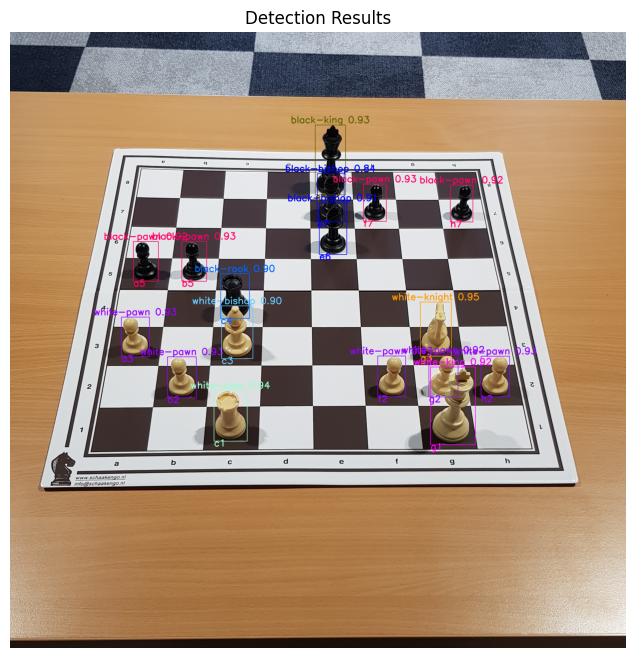

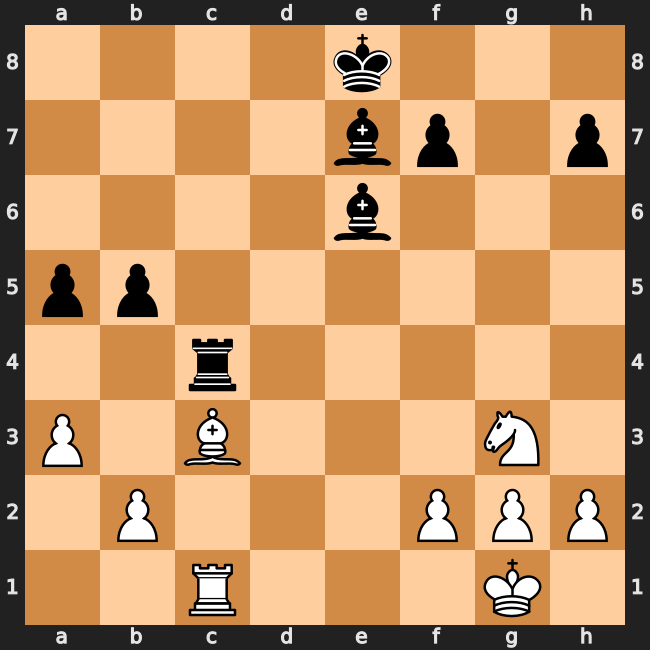

FEN: 4k3/4bp1p/4b3/pp6/2r5/P1B3N1/1P3PPP/2R3K1 w - - 0 1

🔎 Processing G058_IMG074.jpg

0: 640x640 4 white-pawns, 1 white-bishop, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-bishop, 1 black-king, 8.3ms
Speed: 2.7ms preprocess, 8.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


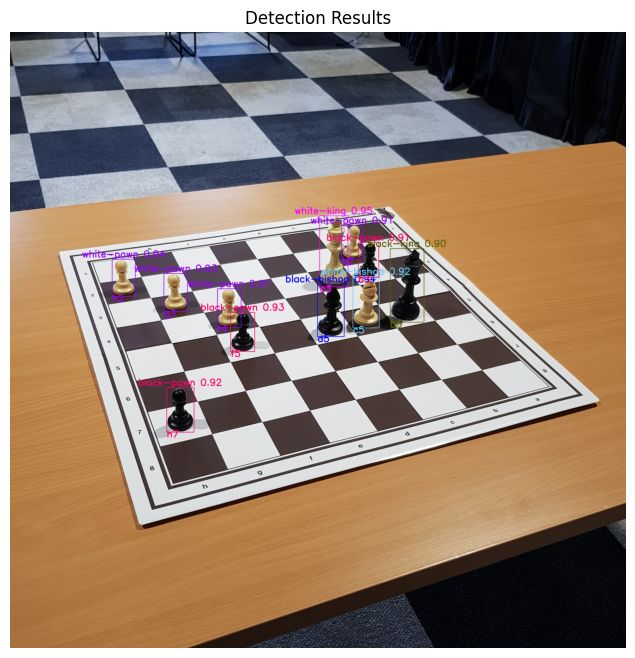

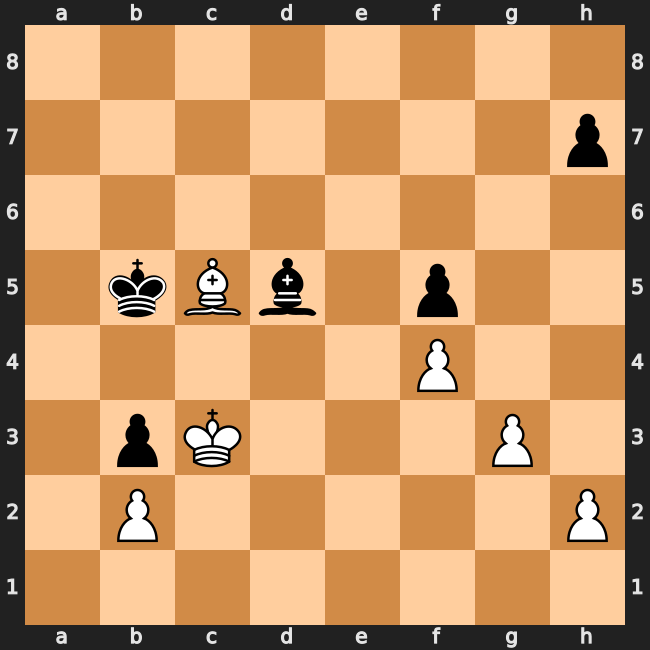

FEN: 8/7p/8/1kBb1p2/5P2/1pK3P1/1P5P/8 w - - 0 1

🔎 Processing G058_IMG100.jpg

0: 640x640 3 white-pawns, 1 white-bishop, 1 white-king, 2 black-pawns, 1 black-bishop, 1 black-king, 7.9ms
Speed: 2.7ms preprocess, 7.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


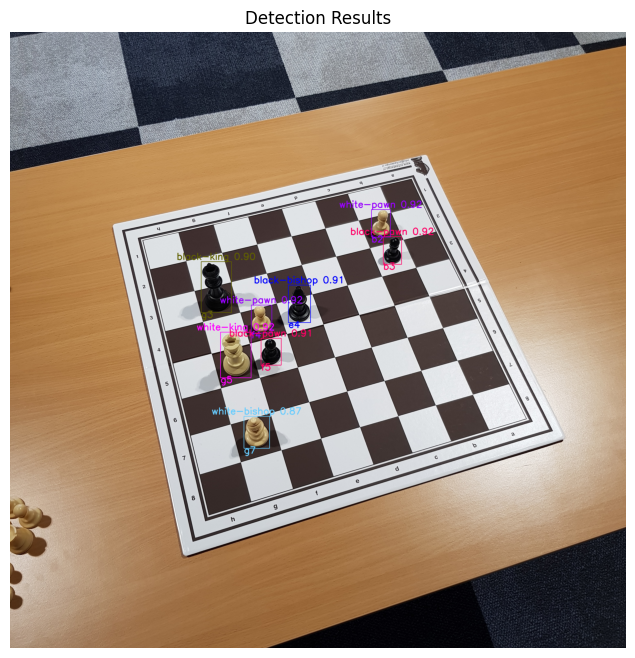

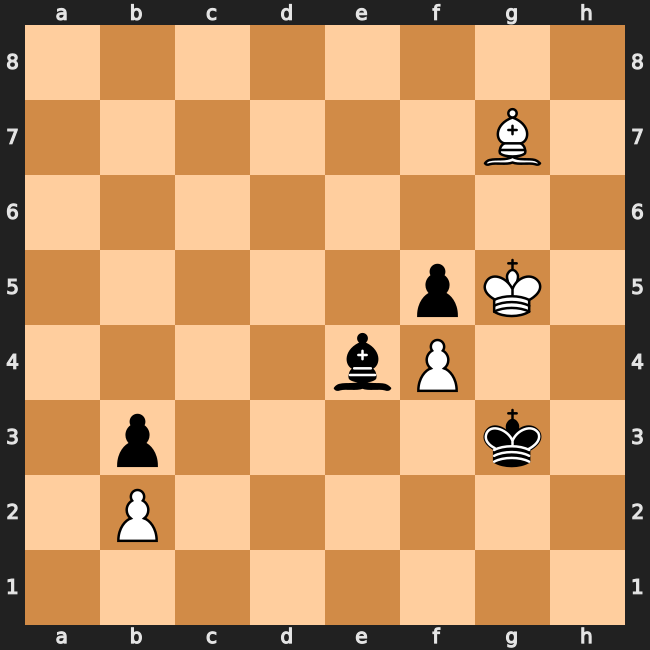

FEN: 8/6B1/8/5pK1/4bP2/1p4k1/1P6/8 w - - 0 1

🔎 Processing G061_IMG080.jpg

0: 640x640 4 white-pawns, 1 white-rook, 1 white-knight, 1 white-bishop, 1 white-king, 7 black-pawns, 1 black-rook, 1 black-bishop, 1 black-king, 9.8ms
Speed: 2.6ms preprocess, 9.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 98.4375%


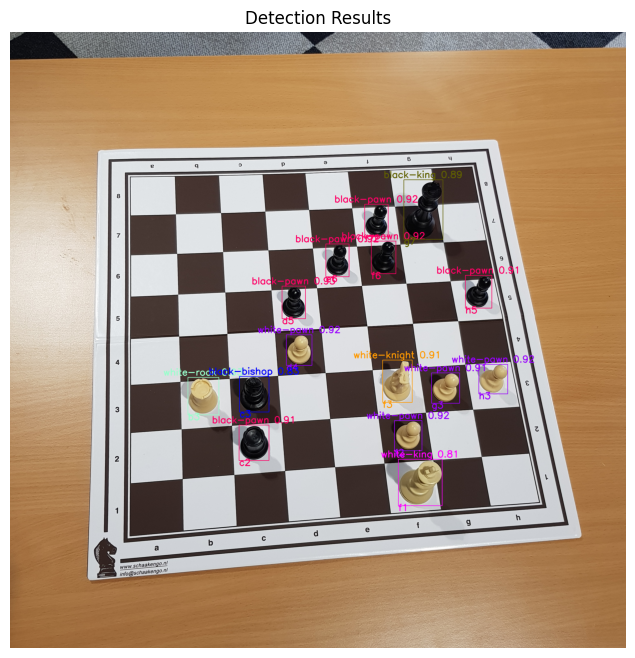

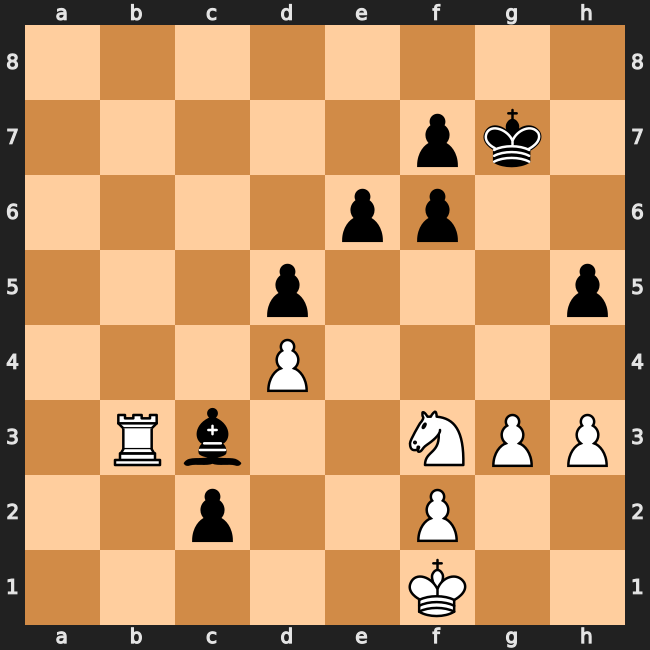

FEN: 8/5pk1/4pp2/3p3p/3P4/1Rb2NPP/2p2P2/5K2 w - - 0 1

🔎 Processing G061_IMG092.jpg

0: 640x640 3 white-pawns, 1 white-rook, 1 white-knight, 1 white-king, 4 black-pawns, 1 black-rook, 1 black-bishop, 1 black-king, 8.8ms
Speed: 3.0ms preprocess, 8.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


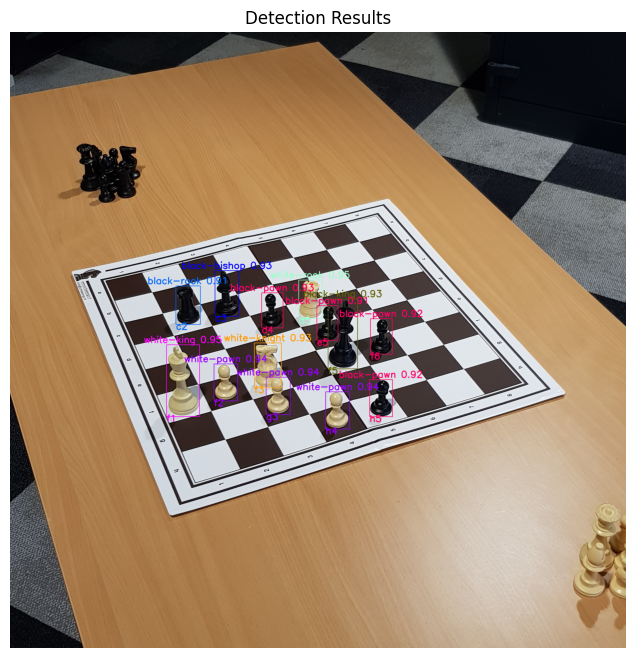

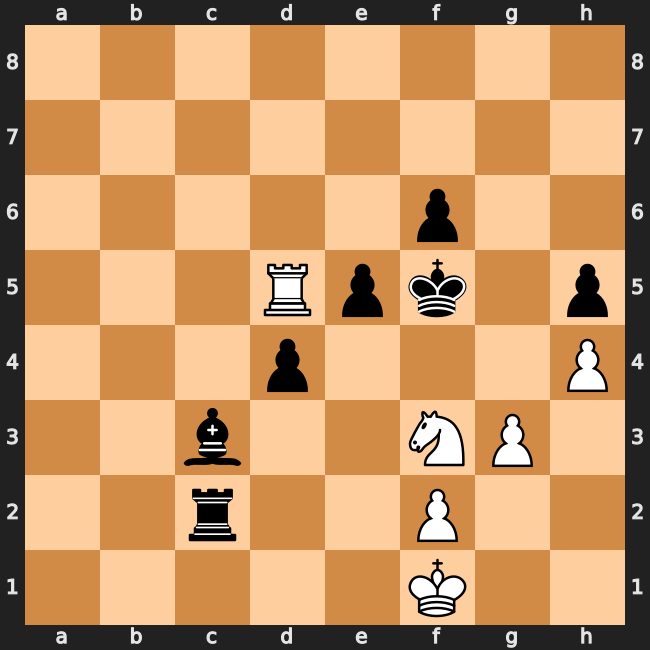

FEN: 8/8/5p2/3Rpk1p/3p3P/2b2NP1/2r2P2/5K2 w - - 0 1

🔎 Processing G061_IMG098.jpg

0: 640x640 3 white-pawns, 1 white-rook, 1 white-knight, 1 white-king, 4 black-pawns, 1 black-rook, 1 black-bishop, 1 black-king, 11.2ms
Speed: 2.6ms preprocess, 11.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


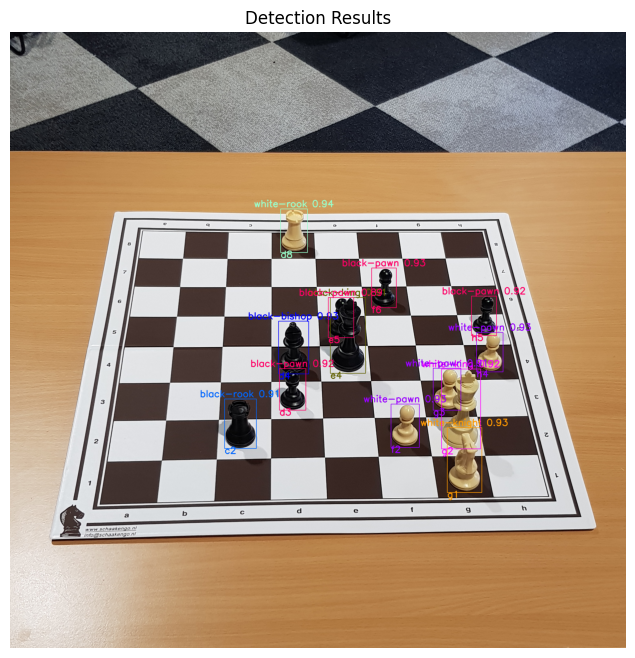

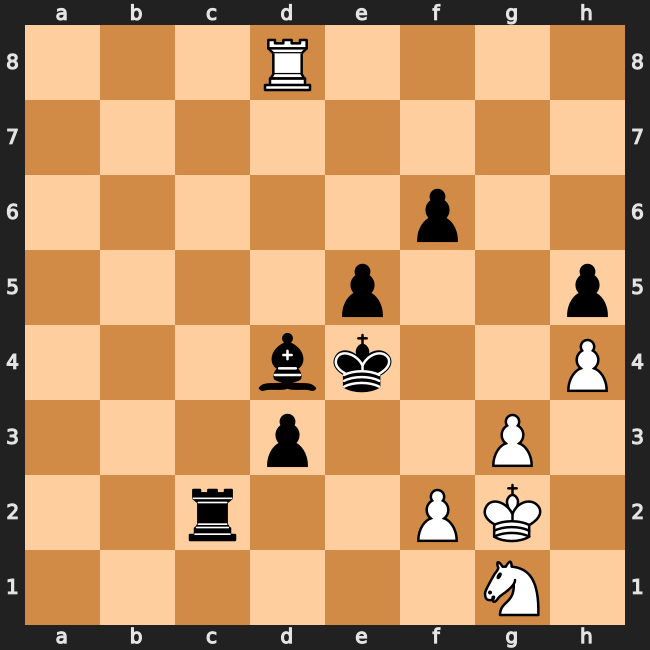

FEN: 3R4/8/5p2/4p2p/3bk2P/3p2P1/2r2PK1/6N1 w - - 0 1

🔎 Processing G072_IMG083.jpg

0: 640x640 3 white-pawns, 1 white-rook, 1 white-knight, 1 white-king, 4 black-pawns, 2 black-rooks, 1 black-king, 11.6ms
Speed: 2.6ms preprocess, 11.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


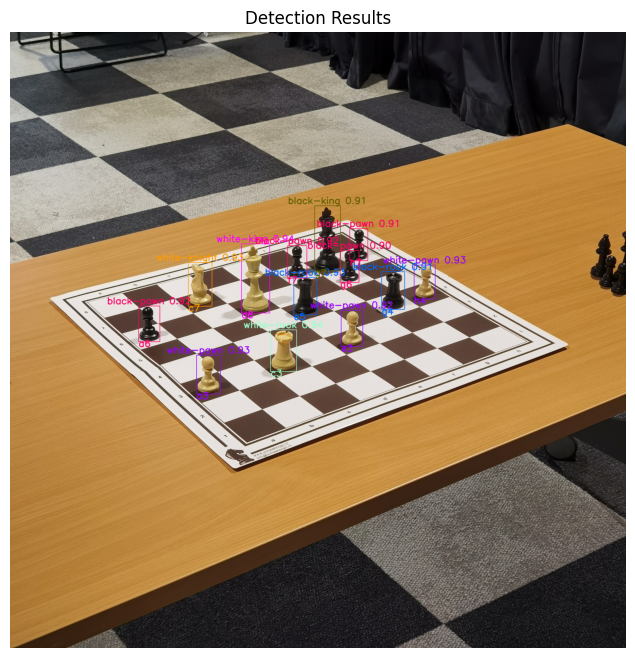

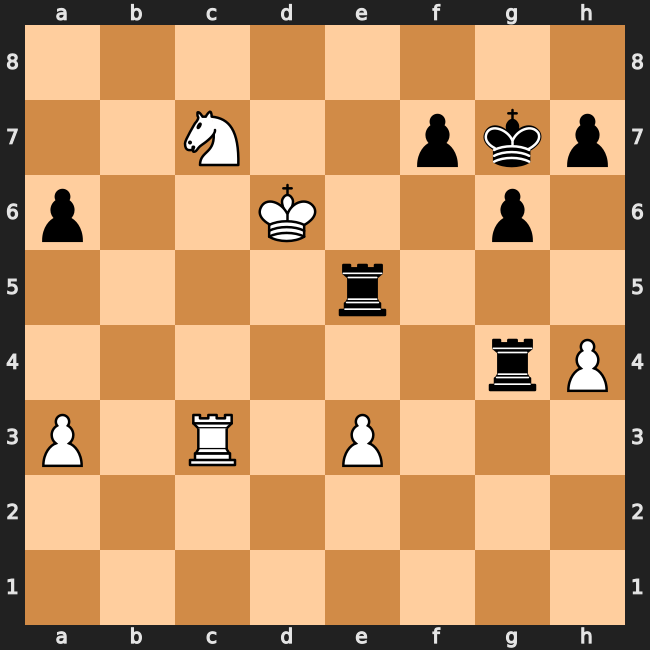

FEN: 8/2N2pkp/p2K2p1/4r3/6rP/P1R1P3/8/8 w - - 0 1

🔎 Processing G072_IMG098.jpg

0: 640x640 1 white-pawn, 1 white-rook, 1 white-knight, 1 white-king, 3 black-pawns, 2 black-rooks, 1 black-king, 12.0ms
Speed: 2.6ms preprocess, 12.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


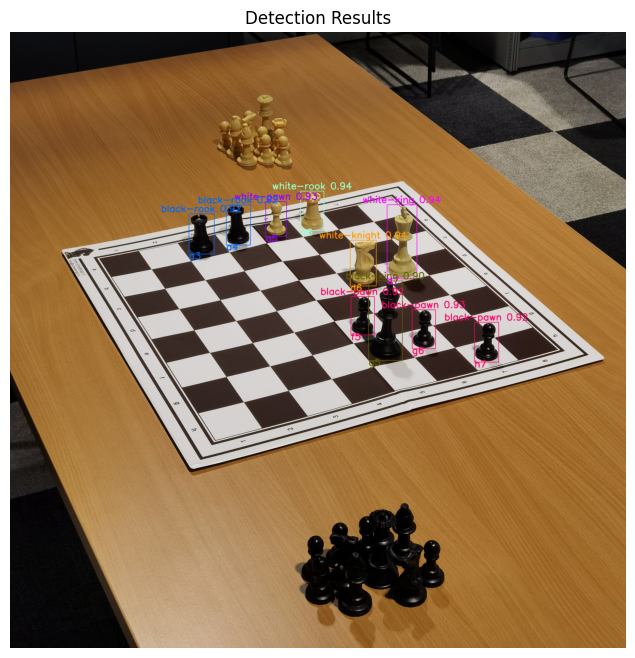

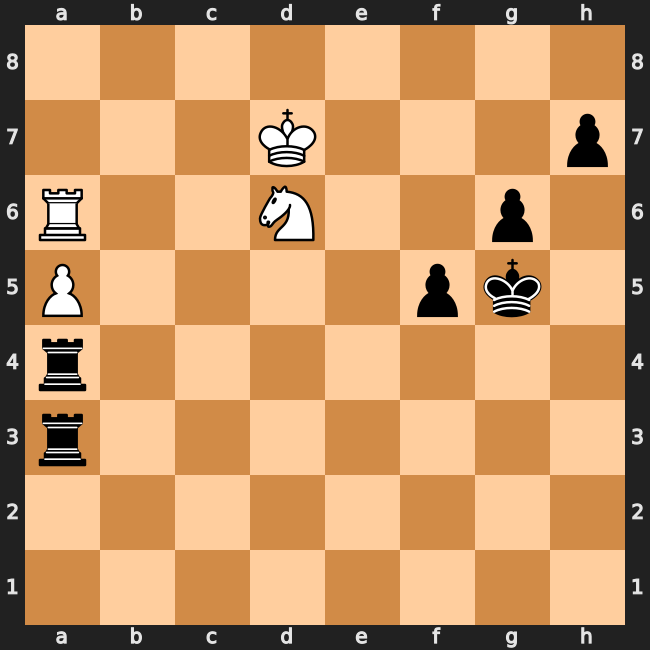

FEN: 8/3K3p/R2N2p1/P4pk1/r7/r7/8/8 w - - 0 1

🔎 Processing G076_IMG072.jpg

0: 640x640 6 white-pawns, 1 white-rook, 1 white-king, 5 black-pawns, 1 black-rook, 1 black-king, 12.8ms
Speed: 2.6ms preprocess, 12.8ms inference, 6.8ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


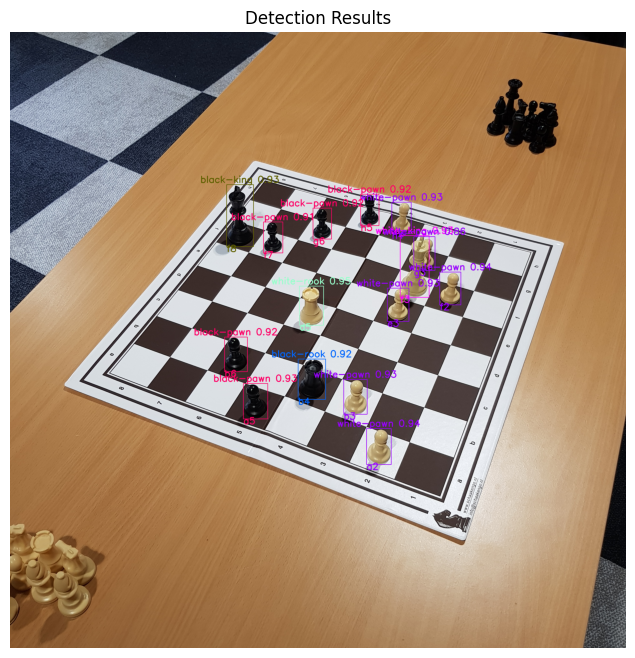

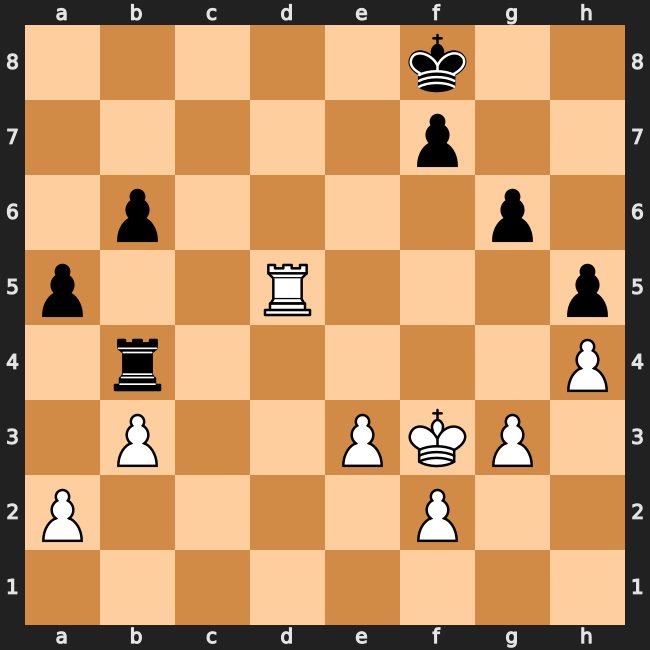

FEN: 5k2/5p2/1p4p1/p2R3p/1r5P/1P2PKP1/P4P2/8 w - - 0 1

🔎 Processing G076_IMG089.jpg

0: 640x640 5 white-pawns, 1 white-rook, 1 white-king, 4 black-pawns, 1 black-rook, 1 black-king, 12.9ms
Speed: 2.8ms preprocess, 12.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


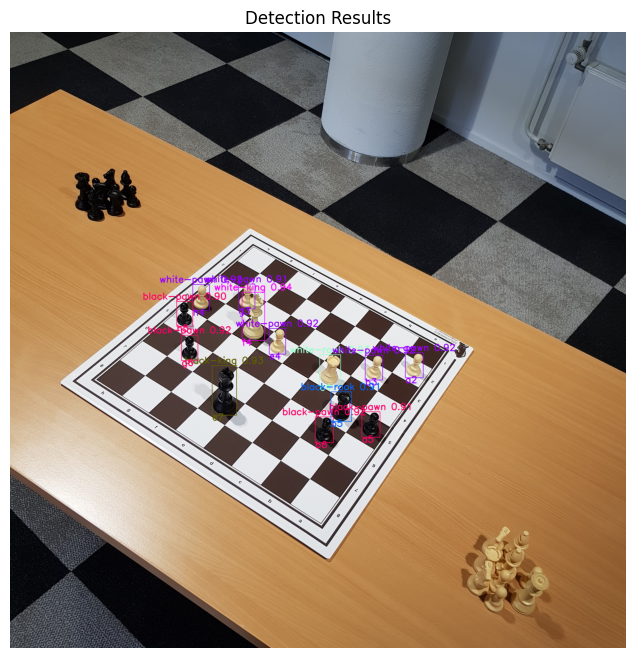

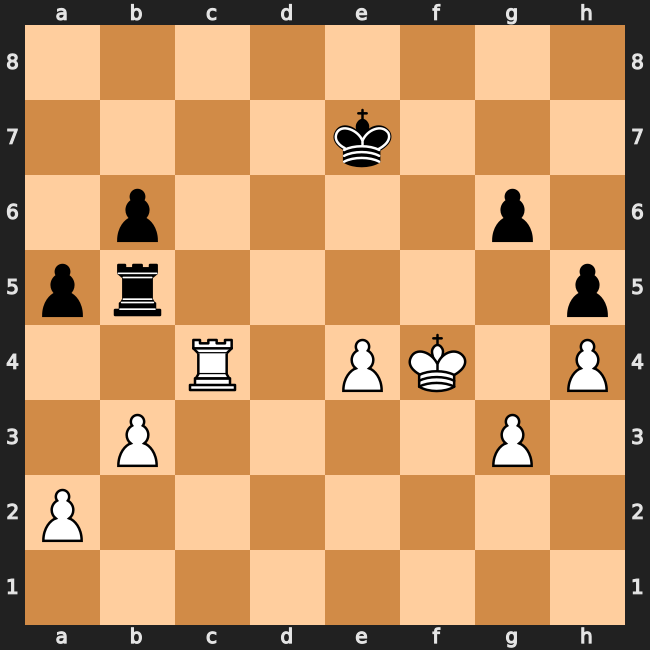

FEN: 8/4k3/1p4p1/pr5p/2R1PK1P/1P4P1/P7/8 w - - 0 1

🔎 Processing G076_IMG095.jpg

0: 640x640 5 white-pawns, 1 white-rook, 1 white-king, 4 black-pawns, 1 black-rook, 1 black-king, 12.3ms
Speed: 2.7ms preprocess, 12.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


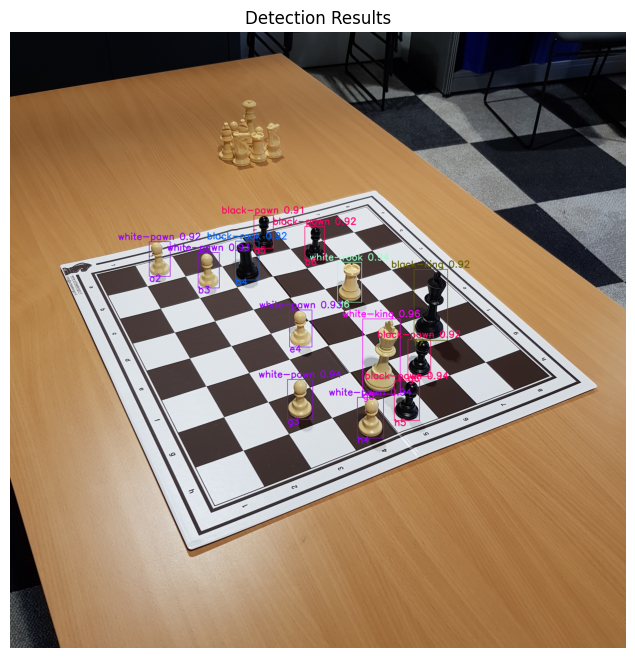

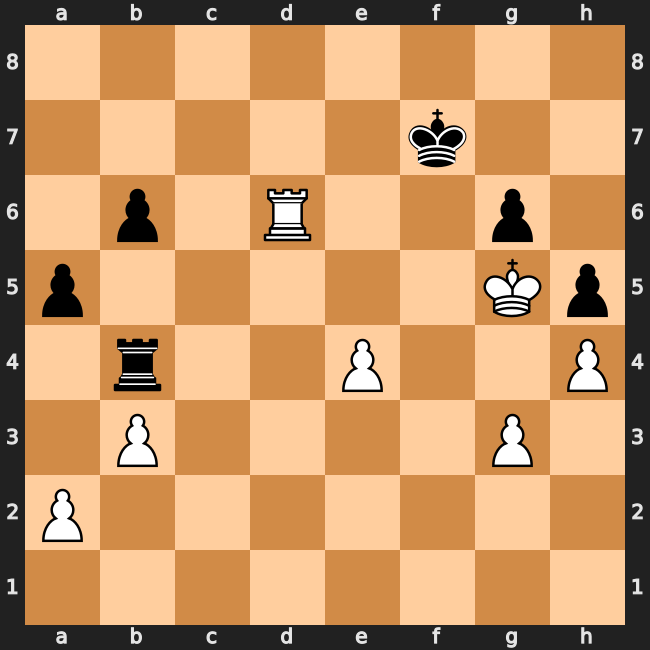

FEN: 8/5k2/1p1R2p1/p5Kp/1r2P2P/1P4P1/P7/8 w - - 0 1

🔎 Processing G078_IMG092.jpg

0: 640x640 2 white-pawns, 1 white-rook, 1 white-king, 2 black-pawns, 1 black-rook, 1 black-king, 15.1ms
Speed: 2.8ms preprocess, 15.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


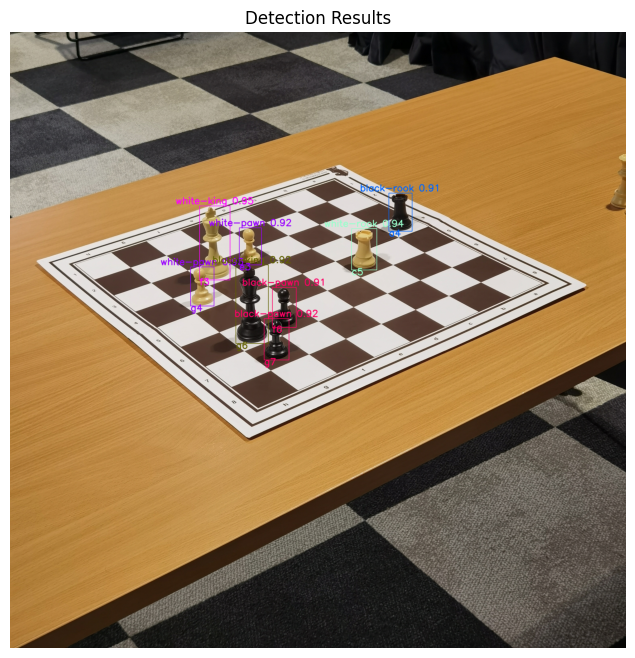

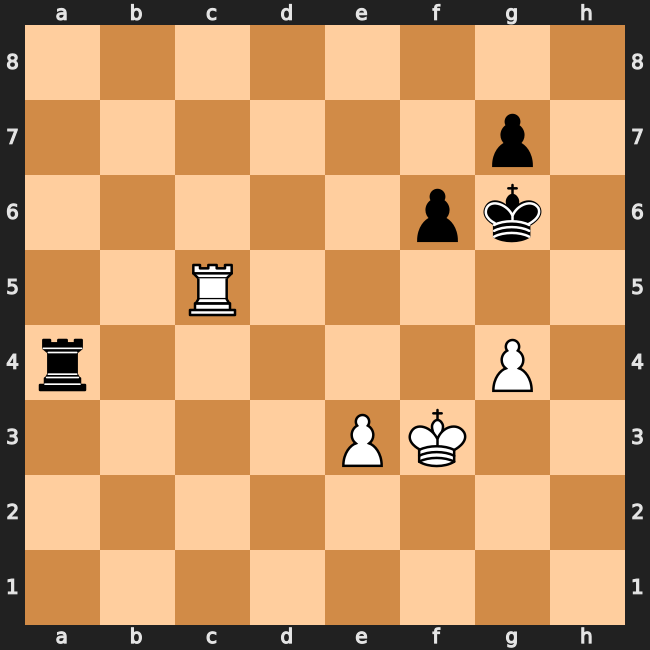

FEN: 8/6p1/5pk1/2R5/r5P1/4PK2/8/8 w - - 0 1

🔎 Processing G083_IMG073.jpg

0: 640x640 4 white-pawns, 1 white-rook, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-king, 14.0ms
Speed: 2.7ms preprocess, 14.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


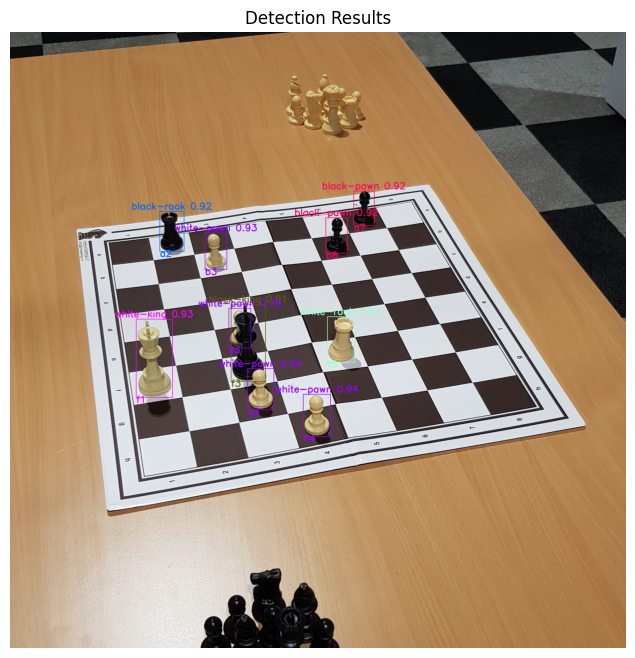

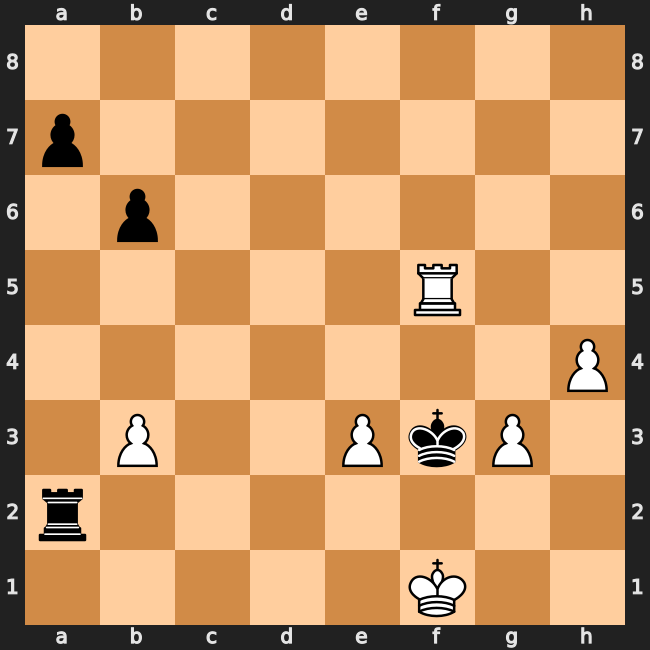

FEN: 8/p7/1p6/5R2/7P/1P2PkP1/r7/5K2 w - - 0 1

🔎 Processing G083_IMG089.jpg

0: 640x640 2 white-pawns, 1 white-rook, 1 white-king, 2 black-pawns, 1 black-rook, 1 black-king, 16.4ms
Speed: 2.7ms preprocess, 16.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


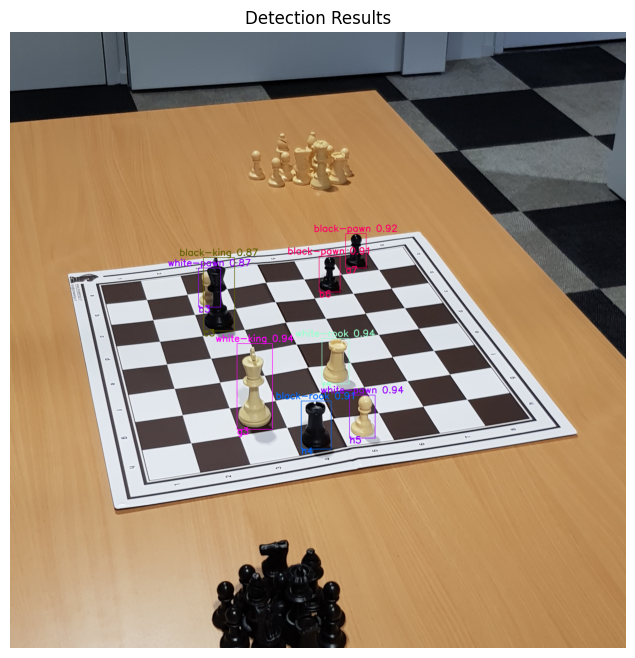

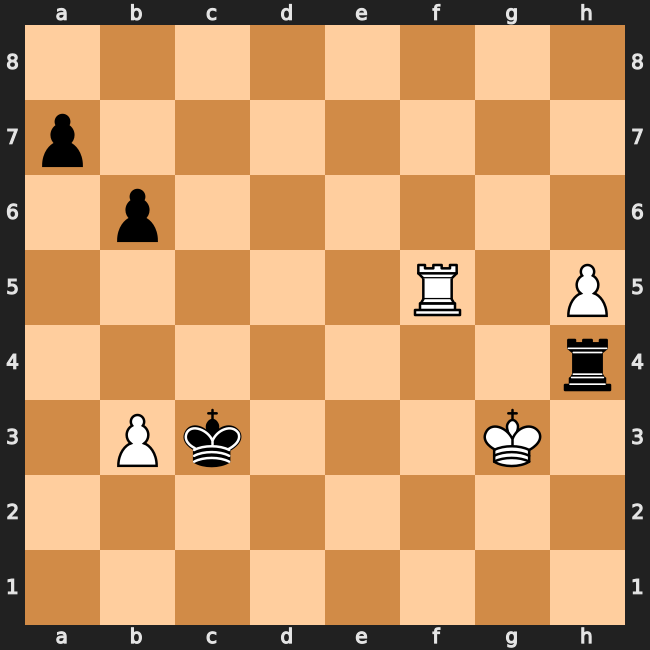

FEN: 8/p7/1p6/5R1P/7r/1Pk3K1/8/8 w - - 0 1

🔎 Processing G087_IMG093.jpg

0: 640x640 3 white-pawns, 2 white-rooks, 1 white-knight, 1 white-bishop, 1 white-king, 6 black-pawns, 2 black-rooks, 1 black-queen, 1 black-king, 15.8ms
Speed: 2.7ms preprocess, 15.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


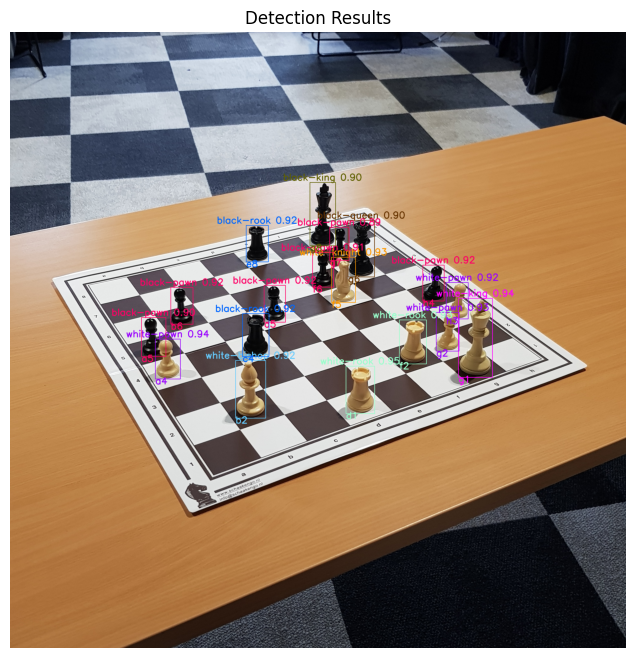

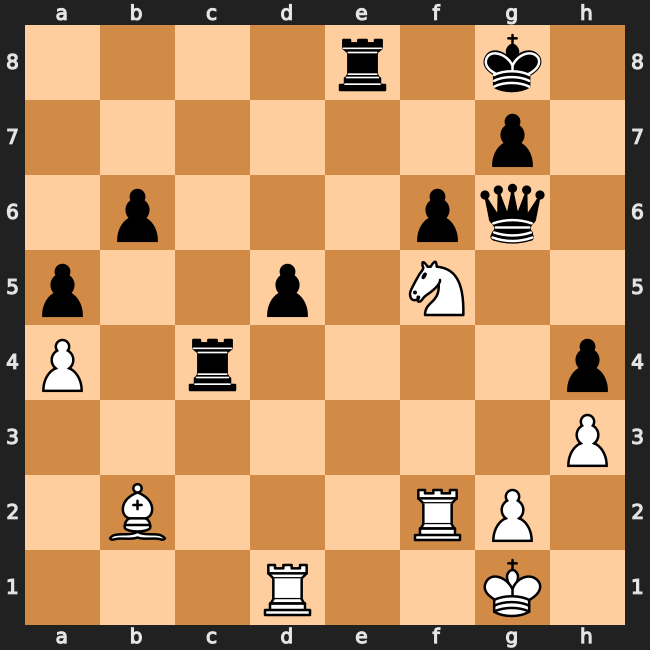

FEN: 4r1k1/6p1/1p3pq1/p2p1N2/P1r4p/7P/1B3RP1/3R2K1 w - - 0 1

🔎 Processing G087_IMG099.jpg

0: 640x640 2 white-pawns, 2 white-rooks, 1 white-knight, 1 white-bishop, 1 white-king, 5 black-pawns, 2 black-rooks, 1 black-queen, 1 black-king, 21.7ms
Speed: 2.7ms preprocess, 21.7ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


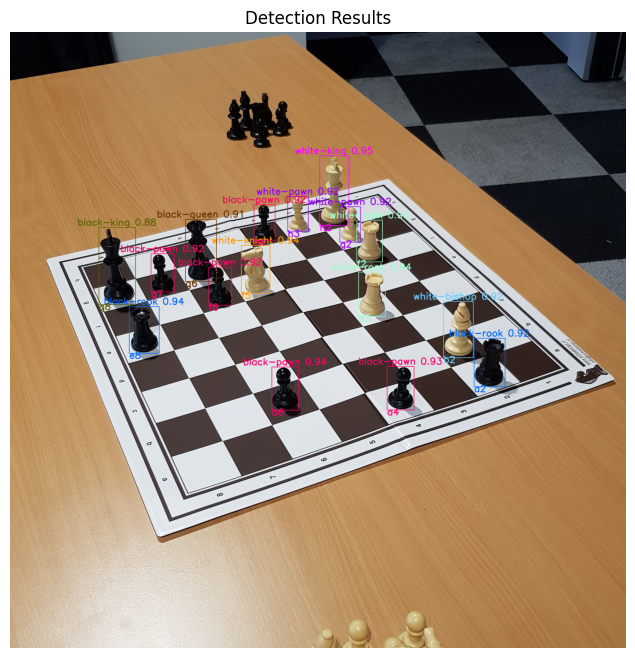

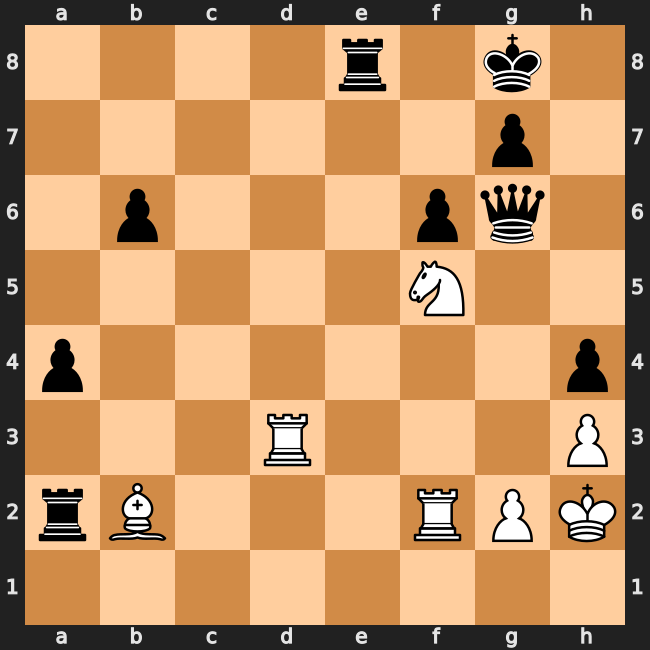

FEN: 4r1k1/6p1/1p3pq1/5N2/p6p/3R3P/rB3RPK/8 w - - 0 1

🔎 Processing G091_IMG053.jpg

0: 640x640 4 white-pawns, 1 white-rook, 2 white-bishops, 1 white-queen, 1 white-king, 6 black-pawns, 2 black-rooks, 1 black-knight, 1 black-queen, 1 black-king, 16.3ms
Speed: 4.8ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


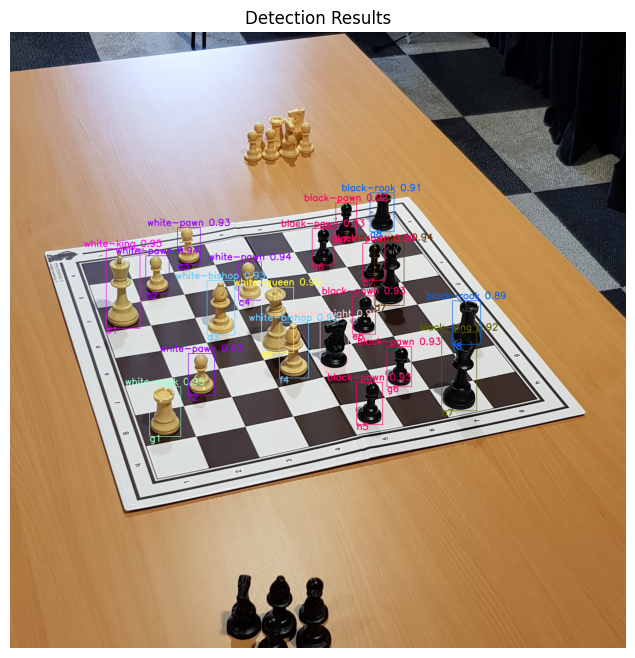

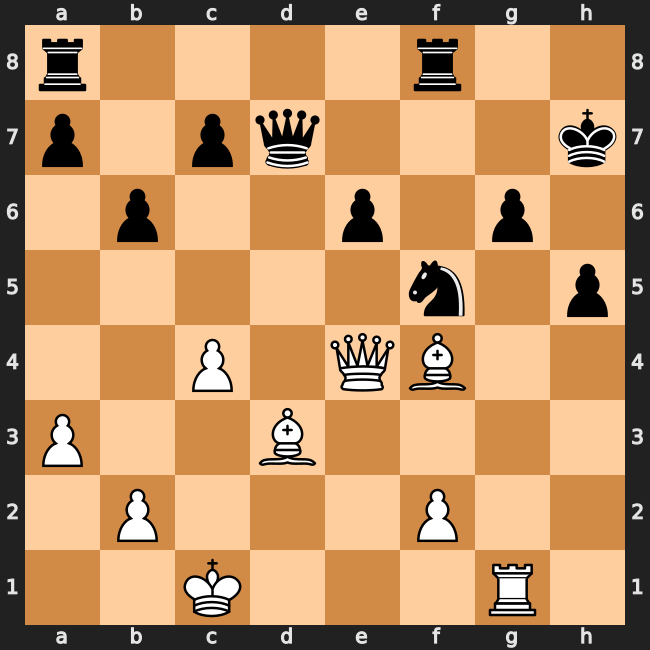

FEN: r4r2/p1pq3k/1p2p1p1/5n1p/2P1QB2/P2B4/1P3P2/2K3R1 w - - 0 1

🔎 Processing G091_IMG074.jpg

0: 640x640 2 white-pawns, 1 white-rook, 2 white-bishops, 1 white-queen, 1 white-king, 6 black-pawns, 2 black-rooks, 1 black-knight, 1 black-queen, 1 black-king, 26.9ms
Speed: 2.8ms preprocess, 26.9ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


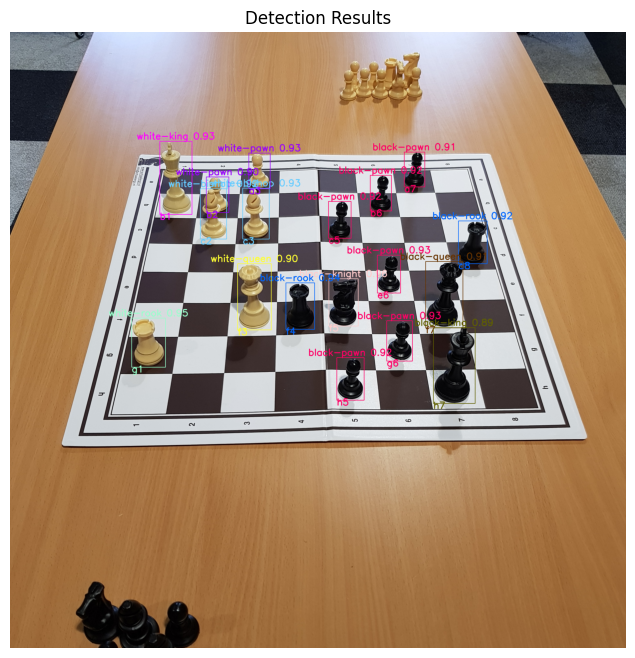

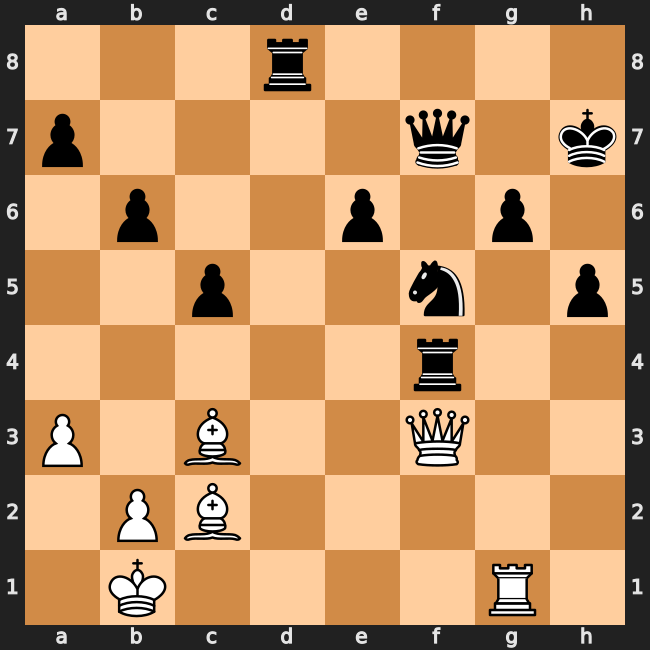

FEN: 3r4/p4q1k/1p2p1p1/2p2n1p/5r2/P1B2Q2/1PB5/1K4R1 w - - 0 1

🔎 Processing G091_IMG102.jpg

0: 640x640 2 white-pawns, 1 white-rook, 2 white-bishops, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-knight, 1 black-king, 8.4ms
Speed: 2.7ms preprocess, 8.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


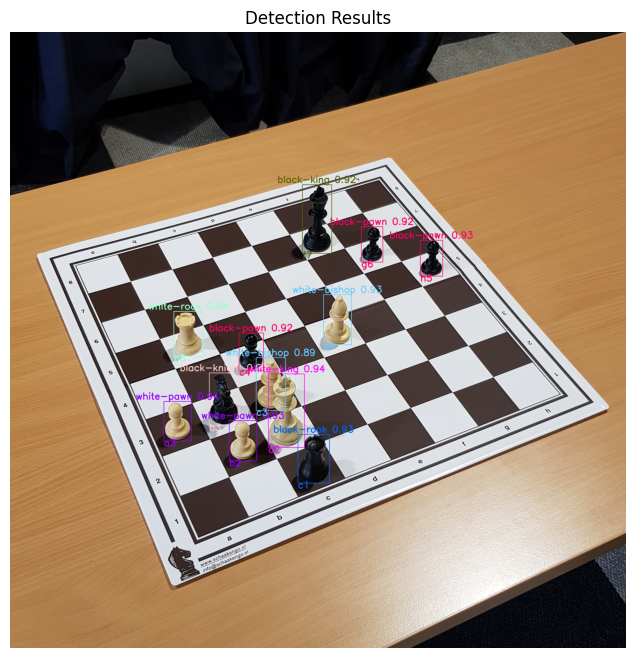

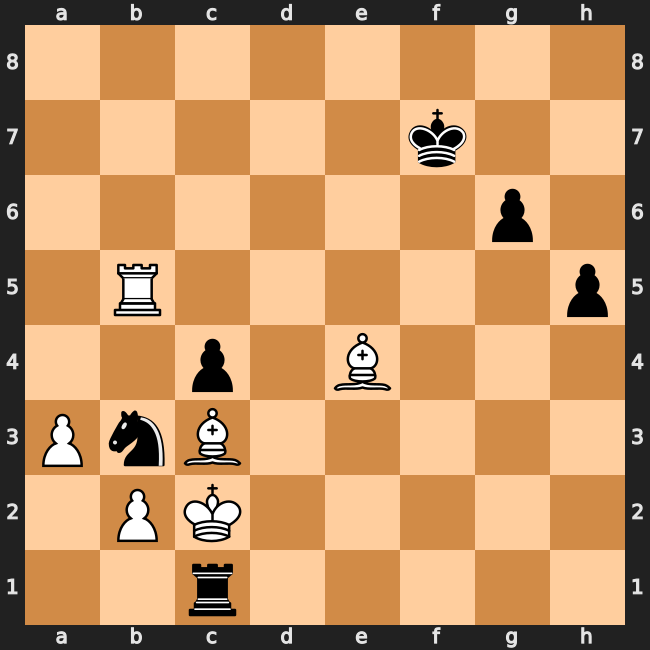

FEN: 8/5k2/6p1/1R5p/2p1B3/PnB5/1PK5/2r5 w - - 0 1

🔎 Processing G099_IMG094.jpg

0: 640x640 5 white-pawns, 1 white-rook, 1 white-knight, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-king, 46.3ms
Speed: 3.7ms preprocess, 46.3ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)
Accuracy: 100.0%


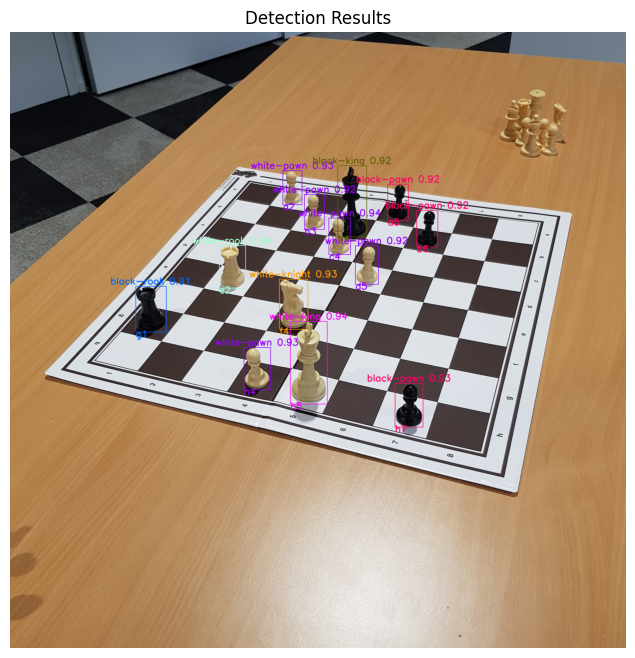

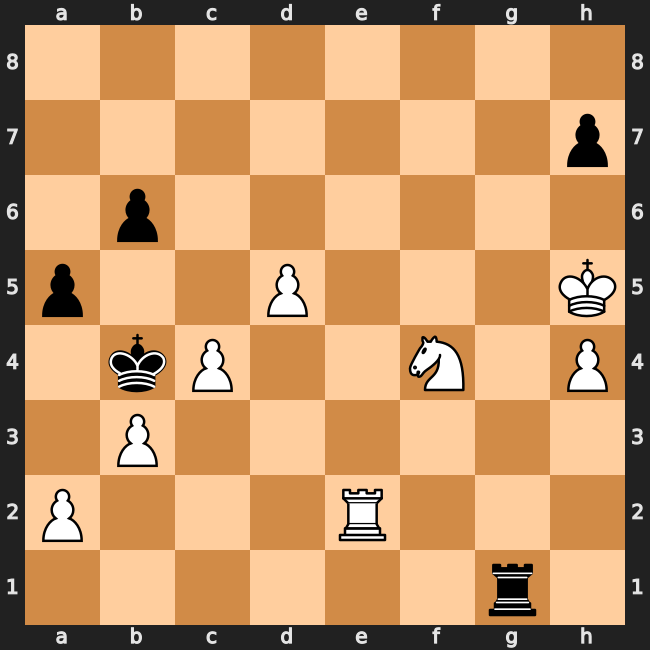

FEN: 8/7p/1p6/p2P3K/1kP2N1P/1P6/P3R3/6r1 w - - 0 1


In [41]:
for key, v in successful_images.items():
    if "horizontal_lines" not in v or "vertical_lines" not in v:
        print(f"Skipping {key}: no grid lines stored.")
        continue

    h_lines = v["horizontal_lines"]
    v_lines = v["vertical_lines"]
    board_size = v['warped_original_rgb'].shape[0]
    crop_margin = int(board_size * 0.07)

    abs_h_lines = [crop_margin] + [y + crop_margin for y in h_lines] + [board_size - crop_margin]
    abs_v_lines = [crop_margin] + [x + crop_margin for x in v_lines] + [board_size - crop_margin]

    grid_pts = [(x, y) for y in abs_h_lines for x in abs_v_lines]
    grid_pts_orig = map_points_back_to_original(grid_pts, v['matrix_full'])
    grid_matrix = np.array(grid_pts_orig).reshape((9, 9, 2))

    print(f"\n🔎 Processing {key}")

    results = model(v['original image'])[0]

    square_detections = []
    img_with_yolo = v['original image'].copy()
    h0 = img_with_yolo.shape[0]

    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        cx = (x1 + x2) // 2
        cy = y2
        square = determine_square_from_point((cx, cy), grid_matrix)

        class_id = int(box.cls[0].item())
        confidence = float(box.conf[0].item())
        class_name = model.names[class_id]
        color = COLORS.get(class_name, (0, 255, 0))

        # Only add detection if it meets the confidence threshold for the given piece type
        if confidence >= CONFIDENCE_THRESHOLDS.get(class_name, 0.5):  # Default threshold if not specified
            square_detections.append({
                "bbox": (x1, y1, x2, y2),
                "center": (cx, cy),
                "square": square,
                "class_id": class_id,
                "confidence": confidence
            })

            # Desenhar bbox
            cv2.rectangle(img_with_yolo, (x1, y1), (x2, y2), color, 2)

            # Label formatado
            label = f"{class_name} {confidence:.2f}"
            font_scale = max(0.30, h0 / 2000)
            text_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, font_scale, 2)[0]
            text_x = x1 + (x2 - x1 - text_size[0]) // 2
            text_y = y1 - 10 if y1 - 10 > text_size[1] else y1 + 30

            cv2.putText(img_with_yolo, label, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, font_scale, color, 4)

            # Mostrar também a posição da peça (casa)
            if square:
                cv2.putText(img_with_yolo, square, (x1, y2 + 25), cv2.FONT_HERSHEY_SIMPLEX, font_scale, color, 4)
        
    v["yolo_detections"] = square_detections
    
    board_matrix = generate_piece_matrix(square_detections, files)
    json_path = os.path.join(TRUTH_MATRIX_FOLDER, key.replace(".jpg", ".json"))
    metrics = evaluate_prediction(json_path, board_matrix)
    print(f"Accuracy: {metrics['accuracy']*100}%")
    v["board_matrix"] = board_matrix

    # print(f"\n📋 Piece matrix for {key}:\n{board_matrix}")
    
    fen = board_matrix_to_fen(board_matrix)
    board = chess.Board(fen=fen)
    
    # Show original image with YOLO detections + FEN SVG
    # Create SVG for chess board visualization
    svg = chess.svg.board(board=board, size=650)
    
    # Display original image with detections
    plt.figure(figsize=(16, 8))
    plt.imshow(cv2.cvtColor(img_with_yolo, cv2.COLOR_BGR2RGB))
    plt.title("Detection Results")
    plt.axis('off')
    plt.show()
    
    # Display SVG separately for better clarity
    display(SVG(svg))
    
    print(f"FEN: {fen}")
